# PROJECT OVERVIEW

James M. Irving

Flatiron Full Time Data Science 021119 Cohort

https://mybinder.org/v2/gh/jirvingphd/bs_ds/master

# ABSTRACT:

> Stock Market prices are notoriously difficult to model, but advances in machine learning algorithms in recent years provide renewed possibilities in accurately modeling market performance. One notable addition in modern machine learning is that of Natural Language Processing (NLP). For those modeling a specific stock, performing NLP feature extraction and analysis on the collection of news headlines, shareholder documents, or social media postings that mention the company can provide additional information about the human/social elements to predicting market behaviors. These insights could not be captured by historical price data and technical indicators alone.

> President Donald J. Trump is one of the most prolific users of social media, specifically Twitter, using it as a direct messaging channel to his followers, avoiding the traditional filtering and restriction that normally controls the public influence of the President of the United States. An additional element of the presidency that Trump has avoided is that of financial transparency and divesting of assets. Historically, this is done in order to avoid conflicts of interest, apparent or actual. The president is also known to target companies directly with his Tweets, advocating for specific changes/decisions by the company, or simply airing his greivances. This leads to the natural question, how much influence *does* President Trump exert over the financial markets? 

> To explore this question, we built multiple types of models attempting to answer this question, using the S&P500 as our market index. First, we built a classification model to predict the change in stock price 60 mins after the tweet. We trained Word2Vec embeddings on President Trump's tweets since his election, which we used as the embedding layer for LSTM and GRU neural networks. 

> We next build a baseline time series regression model, using historical price data alone to predict price by trading-hour. We then built upon this, adding several technical indicators of market performance as additional features. 
Finally, we combined the predicitons of our classification model, as well as several other metrics about the tweets (sentiment scores, # of retweets/favorites, upper-to-lowercase ratio,etc.) to see if combining all of these sources of information could explain even more of the variance in stock market prices. 


## MAIN QUESTION:
> #### **Can the Twitter activity of Donald Trump explain fluctuations in the stock market?**

**We will use a combination of traditional stock market forecasting combined with Natural Language Processing and word embeddings from President Trump's tweets to predict fluctuations in the stock market (using S&P 500 as index).**

- **Question 1: Can we predict if stock prices will go up or down at a fixed time point, based on the language in Trump's tweets?**
    - [NLP Model 0](#Model-0)<br><br>
    
- **Question 2: How well can explain stock market fluctuations using only historical price data?**
    - [Stock Market Model 1](#Model-1:-Using-Price-as-only-feature)<br><br>
- **Question 3: Does adding technical market indicators to our model improve its ability to predict stock prices?**
    - [Stock Market Model 2](#Model-2:-Stock-Price-+-Technical-Indicators)<br><br>
- **Question 4: Can the NLP predictions from Question 1, combined with all of the features from Question 3, as well as additional information regarding Trump's Tweets explain even more of the stock market fluctuations?**
    - Stock Market Model 3
    - Stock Market Model X<br><br>

    
### REFERENCES / INSPIRATION:

1. **Stanford Scientific Poster Using NLP ALONE to predict if stock prices increase or decrease 5 mins after Trump tweets.**  
    - [Poster PDF LINK](http://cs229.stanford.edu/proj2017/final-posters/5140843.pdf)
    - Best accuracy was X, goal 1 is to create a classifier on a longer timescale with superior results.
    

2. **TowardsDataScience Blog Plost on "Using the latest advancements in deep learning to predict stock price movements."** 
     - [Blog Post link](https://towardsdatascience.com/aifortrading-2edd6fac689d)

## OVERVIEW OF DATA/FEATURES USED PER MODEL


#### TWITTER DATA - CLASSIFICATION MODEL
**Trained Word2Vec embeddings on collection of Donal Trump's Tweets.**
- Used negative skip-gram method and negative sampling to best represent infrequently used words.
    
**Classified tweets based on change in stock price (delta_price)**
- Calculated price change from time of tweet to 60 mins later.
    - "No Change" if the delta price was < \\$0.05 
    - "Increase" if delta price was >+\\$0.05
    - "Decrease if delta price was >-\\$0.05
    
*NOTE: This model's predictions will become a feature in our final model.*


#### STOCK MARKET (S&P 500) DATA :
##### TIME SERIES FORECASTING USING MARKET DATA
**Model 1: Use price alone to forecast hourly price.**
- Train model using time sequences of 7-trading-hours (1 day) to predict the following hour. 
    * [x] ~~SARIMAX model~~
    * [x] LSTM neural network 

**Model 2: Use price combined with technical indicators.**
    * LSTM neural network
- **Calculate 7 technical indicators from S&P 500 hourly closing price.**
    * [x] 7 days moving average 
    * [x] 21 days moving average
    * [x] exponential moving average
    * [x] momentum
    * [x] Bollinger bands
    * [x] MACD
    
  

#### FINAL MODEL: COMBINING STOCK MARKET DATA,  NLP CLASSIFICATION, AND OTHER TWEET METRICS
- **FEATURES FOR FINAL MODEL:**<br><br>
    - **Stock Data:**
        * [x] 7 days moving average 
        * [x] 21 days moving average
        * [x] exponential moving average
        * [x] momentum
        * [x] Bollinger bands
        * [x] MACD<br><br>
    - **Tweet Data:**
        * [x] 'delta_price' prediction classification for body of tweets from prior hour (model 0)
        * [x] Number of tweets in hour
        * [x] Ratio of uppercase:lowercase ratio (case_ratio)
        * [x] Total # of favorites for the tweets
        * [x] Total # of retweets for the tweets
        * [x] Sentiment Scores:
            - [x] Individual negative, neutral, and positive sentiment scores
            - [x] Compound Sentiment Score (combines all 3)
            - [x] sentiment class (+/- compound score)    

## OSEMN FRAMEWORK

### [OBTAIN](#OBTAIN)
- Obtaining 1-min resolution stock market data (S&P 500 Index)
- Obtain batch of historical tweets by President Trump 

### [SCRUB](#SCRUB)
1. **[Tweets](#TRUMP'S-TWEETS)**
    - Preprocessing for Natural Language Processing<br><br>
2. **[Stock Market](#Loading-&-Processing-Stock-Data-(SCRUB))**
    - Time frequency conversion
    - Technical Indicator Calculation

### [EXPLORE / VISUALIZE](#EXPLORE/VISUALIZE)
- [Tweet Delta Price Classes](#Delta-Price-Classes) 
- [NLP Figures / Example Tweets](#Natural-Language-Processing)
- [S&P 500 Price](#Model-1:-Using-Price-as-only-feature)
- [S&P 500 Technical Indicators](#Technical-Indicator-Details)

### [MODELING (Initial)](#INITIAL-MODELING)
- [Delta-Stock-Price NLP Classifier](#TWEET-DELTA-PRICE-CLASSIFICATON)
- [S&P 500 Neural Network (price only)] ( )

### iNTERPRETATION 
- Delta-Stock-Price NLP Models
    - Model 0A Summary
    - Model 0B Summary
    
- Stock-Market-Forecasting
    - Model 1 Summary
    - Model 2 Summary
    - Model 3 Summary
    - Model 4 Summary
- Final Summary

# OBTAIN

### DATA SOURCES:

* **All Donald Trump tweets from 12/01/2016 (pre-inaugaration day) to end of 08/23/2018**
    *          Extracted from http://www.trumptwitterarchive.com/

* **Minute-resolution data for the S&P500 covering the same time period.**
    *         IVE S&P500 Index from - http://www.kibot.com/free_historical_data.aspx
    
    
* NOTE: Both sources required manual extraction and both 1-min historical stock data and batch-historical-tweet data are difficult to obtain without paying \\$150-\\$2000 monthly developer memberships. 

# SCRUB

In [1]:
## IMPORT CUSTOM CAPSTONE FUNCTIONS
import functions_combined_BEST as ji
import functions_io as io

from functions_combined_BEST import ihelp, ihelp_menu,\
reload, inspect_variables

## IMPORT MY PUBLISHED PYPI PACKAGE 
import bs_ds as  bs
from bs_ds.imports import *

## IMPORT CONVENIENCE/DISPLAY FUNCTIONS
from pprint import pprint
import qgrid
import json
import ipywidgets as widgets

# Import plotly and cufflinks for iplots
import plotly
import cufflinks as cf
from plotly import graph_objs as go
from plotly.offline import iplot
cf.go_offline()

# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

#Set pd.set_options for tweet visibility
pd.set_option('display.max_colwidth',100)
pd.set_option('display.max_columns',50)

## Saving the sys.stdout to restore later
import sys
__stdout__=sys.stdout

file_dict = io.def_filename_dictionary(load_prior=False, save_directory=True)


from functions_combined_BEST import ihelp_menu2
# file_dict = ji.load_filename_directory()

np.random.seed(42)

bs_ds  v0.9.10 loaded.  Read the docs: https://bs-ds.readthedocs.io/en/latest/index.html
For convenient loading of standard modules use: from bs_ds.imports import *



Package,Handle,Description
bs_ds,bs,Custom data science bootcamp student package
matplotlib,mpl,Matplotlib's base OOP module with formatting artists
matplotlib.pyplot,plt,Matplotlib's matlab-like plotting module
numpy,np,scientific computing with Python
pandas,pd,High performance data structures and tools
seaborn,sns,High-level data visualization library based on matplotlib


------------ Dictionary Contents ------------


interactive(children=(Dropdown(description='dict_to_display', options={'file_directory': {'history': '', 'file…

[i] filename_directory saved to data/filename_dictionary.json.
	 - use `update_file_directory(file_dict)` to update file.
[i] creating all required folders...


## TRUMP'S TWEETS

### Natural Language Processing Info



To prepare Donal Trump's tweets for modeling, **it is essential to preprocess the text** and simplify its contents.
<br><br>
1. **At a minimum, things like:**
    - punctuation
    - numbers
    - upper vs lowercase letters<br>
    ***must*** be addressed before any initial analyses. I refer tho this initial cleaning as **"minimal cleaning"** of the text content<br>
    
> Version 1 of the tweet processing removes these items, as well as the removal of any urls in a tweet. The resulting data column is referred to here as "content_min_clean".

<br><br>
2. It is **always recommended** that go a step beyond this and<br> remove **commonly used words that contain little information** <br>for our machine learning algorithms. Words like: (the,was,he,she, it,etc.)<br> are called **"stopwords"**, and it is critical to address them as well.

> Version 2 of the tweet processing removes these items and the resulting data column is referred here as `cleaned_stopped_content`

<br>

3. Additionally, many analyses **need the text tokenzied** into a list of words<br> and not in a natural sentence format. Instead, they are a list of words (**tokens**) separated by ",", which tells the algorithm what should be considered one word.<br><br>For the tweet processing, I used a version of tokenization, called `regexp_tokenziation` <br>which uses pattern of letters and symbols (the `expression`) <br>that indicate what combination of alpha numeric characters should be considered a single token.<br><br>The pattern I used was `"([a-zA-Z]+(?:'[a-z]+)?)"`, which allows for words such as "can't" that contain "'" in the middle of word. This processes was actually applied in order to process Version 1 and 2 of the Tweets, but the resulting text was put back into sentence form. 

> Version 3 of the tweets keeps the text in their regexp-tokenized form and is reffered to as `cleaned_stopped_tokens`
<br>

4. While not always required, it is often a good idea to reduce similar words down to a shared core.
There are often **multiple variants of the same word with the same/simiar meaning**,<br> but one may plural **(i.e. "democrat" and "democrats")**, or form of words is different **(i.e. run, running).**<br> Simplifying words down to the basic core word (or word *stem*) is referred to as **"stemming"**. <br><br> A more advanced form of this also understands things like words that are just in a **different tense** such as  i.e.  **"ran", "run", "running"**. This process is called  **"lemmatization**, where the words are reduced to their simplest form, called "**lemmas**"<br>  
> Version 4 of the tweets are all reduced down to their word lemmas, futher aiding the algorithm in learning the meaning of the texts.


### Tweet Processing

In [2]:
reload(ji)
func_list = [ji.load_raw_twitter_file,
           ji.make_stopwords_list,
           ji.full_twitter_df_processing,
           ji.full_sentiment_analysis]
ji.ihelp_menu(func_list)

ji.save_ihelp_menu_to_file(func_list,filename='_twitter_processing')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('load_ra…

Output()

Functions saved as readme_resources/ihelp_outputs/_twitter_processing.md


In [3]:
## Load in raw csv of twitter_data, create date_time_index, rename columns
raw_tweets = file_dict['twitter_df']['raw_tweet_file']
twitter_df = ji.load_raw_twitter_file(filename=raw_tweets, 
                         date_as_index=True,
                         rename_map={'text': 'content',
                                     'created_at': 'date'})

## Create list of stopwords for twitter processing
stop_words = ji.make_stopwords_list(incl_punc=True, incl_nums=True,
                                    add_custom=['http','https',
                                                '...','…','``',
                                                'co','“','“','’','‘','”',
                                                "n't","''",'u','s',"'s",
                                                '|','\\|','amp',"i'm","mr"])

## Process twitter data: 
# 1. create minimally cleaned column `content_min_clean` with urls
twitter_df = ji.full_twitter_df_processing(twitter_df,
                                           raw_tweet_col='content',
                                           name_for_cleaned_tweet_col='content_cleaned',
                                           name_for_stopped_col='cleaned_stopped_content', 
                                           name_for_tokenzied_stopped_col='cleaned_stopped_tokens',
                                           use_col_for_case_ratio=None, 
                                           use_col_for_sentiment='content_min_clean',
                                           RT=True, urls=True, hashtags=True, mentions=True,
                                           str_tags_mentions=True,
                                           stopwords_list=stop_words, force=False)
## Display Index information
ji.index_report(twitter_df,label='twitter_df')

## Check for strings that exceed the correct tweet length
keep_idx = ji.check_length_string_column(twitter_df, 'content_min_clean',length_cutoff=400,display_describe=False)
## verify no issues arise.
if keep_idx.isna().sum()>0:
    raise Exception('')
else:
    twitter_df=twitter_df[keep_idx]
    print(f'removed {np.sum(keep_idx==False)}')

ji.check_length_string_column(twitter_df, 'content_min_clean',length_cutoff=400,return_keep_idx=False)
twitter_df.head(2)

[io] Loading raw tweet text file: data/trumptwitterarchive_export_iphone_only__08_23_2019.csv
[i] case_ratio calculated from content_min_clean before text to lowercase
[i] case->lower and punctuation removed from "content_min_clean" 
[i] stopped text column:  cleaned_stopped_content
[i] tokenized stopped text column:  cleaned_stopped_tokens
[i] lemmaztied columns: cleaned_stopped_lemmas
------------------------------------------------------------
	INDEX REPORT:	twitter_df
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 14:37:57 -- to -- 2019-08-24 03:58:32
* Index Freq:
	None
------------------------------------------------------------
	STRING LENGTH REPORT:	"content_min_clean" column
------------------------------------------------------------
[i] Found 2 # of strings above cutoff of 400 chars.
removed 2
------------------------------------------------------------
	STRING LENGTH REPORT:	"content_min_clean" column
----------------------------

,count,mean,std,min,25%,50%,75%,max
content_min_clean,9320,158.038,84.0307,0,102,136,251,310


,source,content,date,retweet_count,favorite_count,is_retweet,id_str,has_RT,starts_RT,content_starts_RT,content_cleaned,content_min_clean,case_ratio,content_hashtags,hashtag_strings,content_mentions,mention_strings,cleaned_stopped_content,cleaned_stopped_tokens,cleaned_stopped_lemmas,sentiment_scores,compound_score,sentiment_class,neg,neu,pos
date,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-12-01 14:37:57,Twitter for iPhone,My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,2016-12-01 14:37:57,12077,65724,False,804333718999539712,False,False,[],My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,my thoughts and prayers are with those affected by the tragic storms and tornadoes in the southe...,0.03906,[],,[],,thoughts prayers affected tragic storms tornadoes southeastern united states stay safe,"[thoughts, prayers, affected, tragic, storms, tornadoes, southeastern, united, states, stay, safe]",thought prayer affected tragic storm tornado southeastern united state stay safe,"{'neg': 0.168, 'neu': 0.623, 'pos': 0.209, 'compound': 0.2732}",0.2732,pos,0.168,0.623,0.209
2016-12-01 22:52:10,Twitter for iPhone,Heading to U.S. Bank Arena in Cincinnati Ohio for a 7pm rally. Join me! Tickets: https://t.co/Hi...,2016-12-01 22:52:10,5564,31256,False,804458095569158144,False,False,[],Heading to U.S. Bank Arena in Cincinnati Ohio for a 7pm rally. Join me! Tickets:,heading to u s bank arena in cincinnati ohio for a 7pm rally join me tickets,0.11111,[],,[],,heading bank arena cincinnati ohio pm rally join tickets,"[heading, bank, arena, cincinnati, ohio, pm, rally, join, tickets]",heading bank arena cincinnati ohio pm rally join ticket,"{'neg': 0.0, 'neu': 0.845, 'pos': 0.155, 'compound': 0.296}",0.2960,pos,0.000,0.845,0.155


In [4]:
## Search all tweets for occurances of specific words
word = 'fed'
idx_russia_tweets = ji.search_for_tweets_with_word(twitter_df, word =word,
                                     display_n=5, from_column='content',
                                     return_index=True, display_df=True)

date,content,retweet_count,favorite_count,source,compound_score,sentiment_class
2019-08-24 01:07:52,RT @MariaBartiromo: The Fed had the Democrats' back for years: Rep. Gohmert https://t.co/0n0KiCvF3n @MorningsMaria @FoxBusiness,6566,0,Twitter for iPhone,0,pos
2019-08-23 14:59:04,....your companies HOME and making your products in the USA. I will be responding to China’s Tariffs this afternoon. This is a GREAT opportunity for the United States. Also I am ordering all carriers including Fed Ex Amazon UPS and the Post Office to SEARCH FOR & REFUSE....,18834,80742,Twitter for iPhone,0.8481,pos
2019-08-23 14:57:40,As usual the Fed did NOTHING! It is incredible that they can “speak” without knowing or asking what I am doing which will be announced shortly. We have a very strong dollar and a very weak Fed. I will work “brilliantly” with both and the U.S. will do great...,15829,67912,Twitter for iPhone,0.6705,pos
2019-08-23 14:40:56,As usual the Fed did NOTHING! It is incredible that they can “speak” without knowing or asking what I am doing which will be announced shortly. We have a very strong dollar and a very weak Fed. I will work “brilliantly” with both and the U.S. will do great...,2329,7811,Twitter for iPhone,0.6705,pos
2019-08-23 13:01:33,Now the Fed can show their stuff!,13354,63624,Twitter for iPhone,0,pos


	 * there are 168 tweets not shown. Next index = 2019-08-22 14:21:52


### Calculating `delta_price_class` for Each Tweet
#### Using S&P 500 Price  1-min-resolution for `delta_price`

In [5]:
func_list = [ji.load_raw_stock_data_from_txt, 
            ji.set_timeindex_freq,
            ji.load_twitter_df_stock_price]

ji.ihelp_menu(func_list)
ji.save_ihelp_menu_to_file(func_list,'_stock_data_to_twitter_data')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('load_ra…

Output()

Functions saved as readme_resources/ihelp_outputs/_stock_data_to_twitter_data.md


#### Add Delta Stock Price Data - For *Each* Tweet

In [6]:
print(f"[i] # number of tweets = {twitter_df.shape[0]}")

## add stock_price for twitter_df
null_ratio = ji.check_null_small(twitter_df,null_index_column='case_ratio')

print(f'[!] {len(null_ratio)} null values for "case_ratio" are tweets containing only urls. Dropping...')
twitter_df.dropna(subset=['is_retweet','case_ratio'],inplace=True)
print(f"[i] New # of tweets = {twitter_df.shape[0]}\n")


twitter_df = ji.load_twitter_df_stock_price(twitter_df, 
                                           get_stock_prices_per_tweet=True,
                                           price_mins_after_tweet=60)

ji.index_report(twitter_df);

idx_null_delta = ji.check_null_small(twitter_df,null_index_column='delta_price');
print(f"[!] {len(idx_null_delta)} null values for 'delta_price' were off-hour tweets,\
more than 1 day before the market reopened. Dropping...")
twitter_df.dropna(subset=['delta_price'], inplace=True)

print(f"\n[i] Final # of tweets = {twitter_df.shape[0]}")

[i] # number of tweets = 9320


------------------------------
Columns with Null Values
------------------------------
is_retweet     56
case_ratio    136
dtype: int64


[!] 136 null values for "case_ratio" are tweets containing only urls. Dropping...
[i] New # of tweets = 9128

[io] Loading 1-minute-resolution stock_prices...
[i] Adding stock_price data for 60 mins post-tweets using `get_stock_prices_for_twitter_data`...
[i] Limiting twitter_df timeindex to match stock_price.
------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 14:37:57 -- to -- 2019-08-23 14:59:05
* Index Freq:
	None


------------------------------
Columns with Null Values
------------------------------
stock_price_results    2344
B_ts_rounded           2344
pre_tweet_price        2344
mins_after_tweet       2344
B_ts_post_tweet        2344
post_tweet_price       2344
delta_time             2344
delta_

In [7]:
ji.column_report(twitter_df,as_df=True)

,column name,dtypes,# zeros,# null,% null,Notes
".iloc[:,i]",,,,,,
0,source,object,0.0,0,0.0,
1,content,object,0.0,0,0.0,
2,date,datetime64[ns],0.0,0,0.0,
3,retweet_count,int64,0.0,0,0.0,
4,favorite_count,int64,1364.0,0,0.0,
5,is_retweet,object,5395.0,0,0.0,
6,id_str,int64,0.0,0,0.0,
7,has_RT,bool,5361.0,0,0.0,
8,starts_RT,bool,5395.0,0,0.0,


### Determining Cutoffs for Delta Price Classes

In [8]:
## Examine delta_price
print("CURRENT # OF POSTITIVE AND NEGATIVE PRICE DELTAS:")
print(twitter_df['delta_price_class'].value_counts())

## Examining Changes to classes if use a "No Change" cutoff of $0.05
delta_price = twitter_df['delta_price']
small_pos =[ 0 < x <.05 for x in delta_price] #/len(delta_price)
small_neg = [-.05<x <0 for x in delta_price]

print('\nCHANGES TO CLASSES IF USING ATHRESHOLD OF $0.05:\n','---'*12)
print(f'# Positive Delta -> "No Change" = {np.sum(small_pos)}')
print(f'# Negative Delta -> "No Change" = {np.sum(small_neg)}')
print(f'# of Unchanged Classifications =  {len(delta_price)-(np.sum(small_pos)+np.sum(small_neg))}')

CURRENT # OF POSTITIVE AND NEGATIVE PRICE DELTAS:
pos    3897
neg    2861
Name: delta_price_class, dtype: int64

CHANGES TO CLASSES IF USING ATHRESHOLD OF $0.05:
 ------------------------------------
# Positive Delta -> "No Change" = 526
# Negative Delta -> "No Change" = 545
# of Unchanged Classifications =  5687


In [9]:
## BIN DELTA PRICE CLASS
bins = pd.IntervalIndex.from_tuples([ (-np.inf,-.05), (-.05,.05), (.05,np.inf)], closed='left')
## Save indexer column for 'delta_price'
twitter_df['indexer'] = bins.get_indexer(twitter_df['delta_price'])

# remap -1,0,1,2 to classes
mapper ={-1:np.nan, 0:0, 1:1,2:2}
# remap string classes
mapper2 = {0:'neg', 1:'no_change',2:'pos'}

## Use indexer to map new integer values
twitter_df['delta_price_class_int']= twitter_df['indexer'].apply(lambda x: mapper[x])
twitter_df['delta_price_class'] = twitter_df['delta_price_class_int'].apply(lambda x: mapper2[x])

## Verify mapping of string and integer classes
res1 = pd.DataFrame(twitter_df['delta_price_class'].value_counts())
res2 = pd.DataFrame(twitter_df['delta_price_class_int'].value_counts())
bs.display_side_by_side(res1,res2)

,delta_price_class
pos,3371
neg,2250
no_change,1137
,delta_price_class_int
2,3371
0,2250
1,1137


## EXPLORE/VISUALIZE 
### Delta Price Classes

In [10]:
ji.plotly_price_histogram(twitter_df,show_fig=True,as_figure=False)
ji.plotly_pie_chart(twitter_df, column_to_plot='delta_price_class',show_fig=True, as_figure=False)

### NLP by Delta Price Class

- For comparison of words and bigrams, we will exclude the 'no change' class. 

In [11]:
nlp_df = twitter_df.loc[twitter_df['delta_price_class']!='no_change'].copy()
nlp_df.dropna(inplace=True)
nlp_df.head(2)

,source,content,date,retweet_count,favorite_count,is_retweet,id_str,has_RT,starts_RT,content_starts_RT,content_cleaned,content_min_clean,case_ratio,content_hashtags,hashtag_strings,content_mentions,mention_strings,cleaned_stopped_content,cleaned_stopped_tokens,cleaned_stopped_lemmas,sentiment_scores,compound_score,sentiment_class,neg,neu,pos,day,time,dayofweek,B_day,B_shifted,B_time,B_dt_index,time_shift,B_dt_minutes,stock_price_results,null_results,B_ts_rounded,pre_tweet_price,mins_after_tweet,B_ts_post_tweet,post_tweet_price,delta_time,delta_price,delta_price_class,delta_price_class_int,indexer
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-12-01 14:37:57,Twitter for iPhone,My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,2016-12-01 14:37:57,12077,65724,False,804333718999539712,False,False,[],My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,my thoughts and prayers are with those affected by the tragic storms and tornadoes in the southe...,0.03906,[],,[],,thoughts prayers affected tragic storms tornadoes southeastern united states stay safe,"[thoughts, prayers, affected, tragic, storms, tornadoes, southeastern, united, states, stay, safe]",thought prayer affected tragic storm tornado southeastern united state stay safe,"{'neg': 0.168, 'neu': 0.623, 'pos': 0.209, 'compound': 0.2732}",0.2732,pos,0.168,0.623,0.209,2016-12-01,14:37:57,Thursday,2016-12-01,False,14:37:57,2016-12-01 14:37:57,0 days,2016-12-01 14:38:00,"{'B_ts_rounded': 2016-12-01 14:38:00, 'pre_tweet_price': 93.97, 'mins_after_tweet': 60, 'B_ts_po...",False,2016-12-01 14:38:00,93.97,60.0,2016-12-01 15:38:00,93.82,01:00:00,-0.15,neg,0,0
2016-12-01 22:52:10,Twitter for iPhone,Heading to U.S. Bank Arena in Cincinnati Ohio for a 7pm rally. Join me! Tickets: https://t.co/Hi...,2016-12-01 22:52:10,5564,31256,False,804458095569158144,False,False,[],Heading to U.S. Bank Arena in Cincinnati Ohio for a 7pm rally. Join me! Tickets:,heading to u s bank arena in cincinnati ohio for a 7pm rally join me tickets,0.11111,[],,[],,heading bank arena cincinnati ohio pm rally join tickets,"[heading, bank, arena, cincinnati, ohio, pm, rally, join, tickets]",heading bank arena cincinnati ohio pm rally join ticket,"{'neg': 0.0, 'neu': 0.845, 'pos': 0.155, 'compound': 0.296}",0.2960,pos,0.000,0.845,0.155,2016-12-01,22:52:10,Thursday,2016-12-01,False,22:52:10,2016-12-01 22:52:10,0 days,2016-12-01 22:52:00,"{'B_ts_rounded': 2016-12-02 09:30:00, 'pre_tweet_price': 93.97, 'mins_after_tweet': 60, 'B_ts_po...",False,2016-12-02 09:30:00,93.97,60.0,2016-12-02 10:30:00,94.03,01:00:00,0.06,pos,2,2


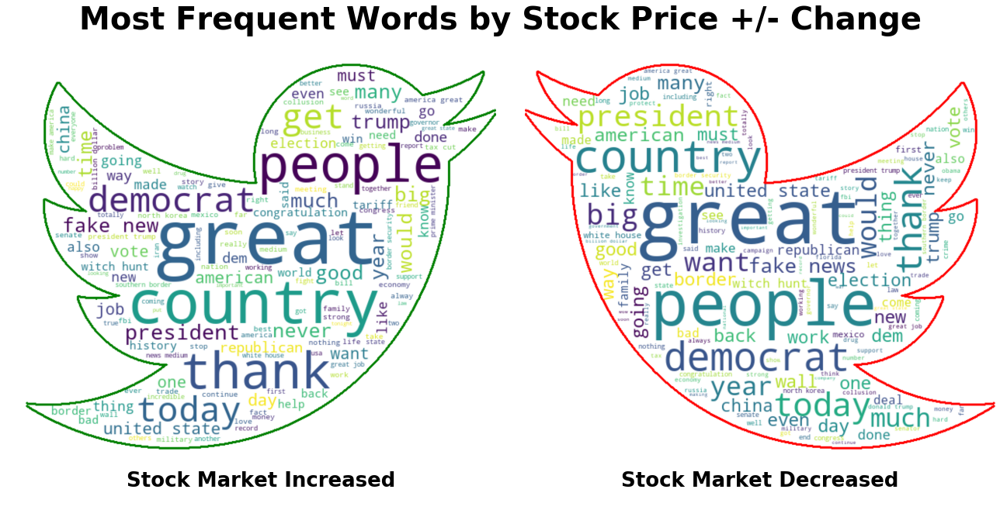

figured saved as figures/wordcloud_top_words_by_delta_price.png


In [12]:
# Generate wordclouds
twitter_df_groups,twitter_group_text = ji.get_group_texts_for_word_cloud(nlp_df, 
                                                                      text_column='cleaned_stopped_lemmas', 
                                                                      groupby_column='delta_price_class')


ji.compare_word_clouds(text1=twitter_df_groups['pos']['joined'],
                       label1='Stock Market Increased',
                       text2= twitter_df_groups['neg']['joined'],
                       label2='Stock Market Decreased',
                       twitter_shaped = True, verbose=1,
                       suptitle_y_loc=0.75,
                       suptitle_text='Most Frequent Words by Stock Price +/- Change',
                       wordcloud_cfg_dict={'collocations':True},
                       save_file=True,filepath_folder='',
                       png_filename=file_dict['nlp_figures']['word_clouds_compare'],
                      **{'subplot_titles_fontdict':{'fontsize':26,'fontweight':'bold'},
                        'suptitle_fontdict':{'fontsize':40,'fontweight':'bold'},
                         'group_colors':{'group1':'green','group2':'red'},
                        });

Unique Text1 Words,Frequency
bank,19
mccain,13
con,12
era,12
wallace,9
closer,8
singapore,8
partner,8
nervous,8
friendship,8


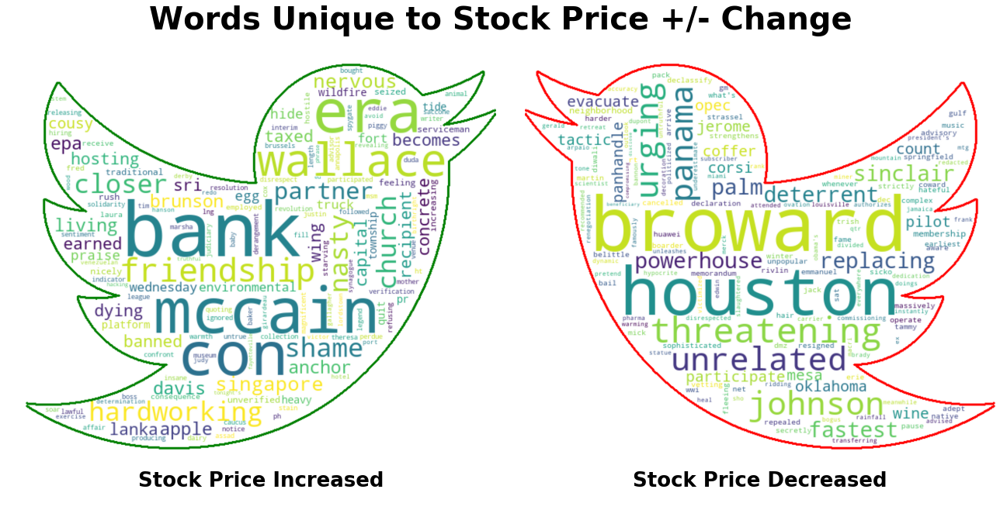

figured saved as figures/wordcloud_unique_words_by_delta_price.png


In [13]:
## Comparing words ONLY unique to each group
df_pos_words, df_neg_words = ji.compare_freq_dists_unique_words(text1=twitter_df_groups['pos']['text_tokens'],
                                                                label1='Price Increased',
                                                                text2=twitter_df_groups['neg']['text_tokens'],
                                                                label2='Price Decreased',
                                                                top_n=20, display_dfs=True,
                                                                return_as_dicts=False)

pos_freq_dict, neg_freq_dict = ji.compare_freq_dists_unique_words(text1=twitter_df_groups['pos']['text_tokens'],
                                                                label1='Price Increased',
                                                                text2=twitter_df_groups['neg']['text_tokens'],
                                                                label2='Price Decreased',
                                                                top_n=20, display_dfs=False,
                                                                return_as_dicts=True)


## WORDCLOUD OF WORDS UNIQUE TO TWEETS THAT INCREASED VS DECREASED STOCK PRICE
ji.compare_word_clouds(text1= pos_freq_dict,label1='Stock Price Increased',
                       text2=neg_freq_dict, label2='Stock Price Decreased',
                       twitter_shaped=True, from_freq_dicts=True,
                       suptitle_y_loc=0.75,wordcloud_cfg_dict={'collocations':True},
                       suptitle_text='Words Unique to Stock Price +/- Change',
                       save_file=True,filepath_folder='',
                       png_filename=file_dict['nlp_figures']['word_clouds_compare_unique'],
                       **{'subplot_titles_fontdict':
                         {'fontsize':26,
                         'fontweight':'bold'},
                        'suptitle_fontdict':{
                         'fontsize':40,
                         'fontweight':'bold'},
                         'group_colors':{
                             'group1':'green','group2':'red'}
                        });

In [14]:
ji.make_tweet_bigrams_by_group(twitter_df_groups)

,Frequency
Bigram,
fake news,0.00310073
united states,0.00258896
witch hunt,0.00174604
white house,0.00162562
president trump,0.00138479
north korea,0.00135469
border security,0.00129448
america great,0.00120417
southern border,0.00105365


# INITIAL MODELING

## TWEET DELTA PRICE CLASSIFICATON

### Creating Word Embeddings with Word2Vec

In [15]:
func_list = [ji.make_word2vec_model,ji.get_wv_from_word2vec,
            ji.get_w2v_kwargs,ji.Word2vecParams]
ihelp_menu(func_list)
ji.save_ihelp_menu_to_file(func_list,'_word2vec')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('make_wo…

Output()

Functions saved as readme_resources/ihelp_outputs/_word2vec.md


In [16]:
## Loading custom class for tracking Word2Vec parameters
w2vParams = ji.Word2vecParams()        
w2vParams.params_template()

[i] call .params_template() for dict to copy/pate.
#TEMPLATE(call.show_info() for details:

        w2vparams = {
        'text_column': 'cleaned_stopped_lemmas',
        'window':3-5,
        'min_count':1-3,
        'epochs':10-20,
        'sg':0 or 1, 
        'hs':'0 or 1,
        'negative': 0 or 5-20 ,
        'ns_exponent':-1.0 to 1.0
        }


In [17]:
## FITING WORD2VEC AND TOKENIZER    
params = {
'text_column': 'cleaned_stopped_lemmas',
'window':3,
'min_count':2,
'epochs':10,
'sg':0, 
'hs':1,
'negative':0,
'ns_exponent':0.0
}
model_kwds=  ji.get_w2v_kwargs(params)    

# text_data = twitter_df[params['text_column']]
## using df_tokenize for full body of a text for word2vec
word2vec_model = ji.make_word2vec_model(twitter_df,
                                        text_column = params['text_column'],
                                        window = params['window'],
                                        min_count= params['min_count'],
                                        epochs = params['epochs'],
                                        verbose=1,
                                        return_full=True,
                                        **model_kwds)

w2vParams.append(params)

wv = word2vec_model.wv

### USING WORD VECTOR MATH TO GET A FEEL FOR QUALITY OF MODEL
wv = word2vec_model.wv
def V(string,wv=wv):
    return wv.get_vector(string)
def equals(vector,wv=wv):
    return wv.similar_by_vector(vector)

list_of_equations = ["V('republican')-V('honor')",
                    "V('man')+V('power')",
                     "V('russia')+V('honor')",
                     "V('china')+V('tariff')",
                     "V('trump')+V('lie')"]

for eqn in list_of_equations:
    print(f'\n* {eqn} =')
    res = eval(f"equals({eqn})")
    [print('\t',x) for x in res]

[i] Training Word2Vec model using:
	{'min_count': 2, 'window': 3, 'epochs': 10, 'sg': 0, 'hs': 1, 'negative': 0, 'ns_exponent': 0.0}
	[i] Training complete. model vocab has 5216 words, with vector size 300.
	[o] returned model is full model.
- params saved.

* V('republican')-V('honor') =
	 ('dems', 0.6307147741317749)
	 ('republican', 0.6053822040557861)
	 ('worry', 0.5591632723808289)
	 ('shutdown', 0.5206741094589233)
	 ('change', 0.5176849365234375)
	 ('whether', 0.5105596780776978)
	 ('idea', 0.4953691363334656)
	 ('democrat', 0.4916568398475647)
	 ('mean', 0.4869893789291382)
	 ('shot', 0.48267611861228943)

* V('man')+V('power') =
	 ('man', 0.8326027393341064)
	 ('power', 0.6319494843482971)
	 ('praying', 0.5926462411880493)
	 ('federalist', 0.585486888885498)
	 ('rudy', 0.5746245384216309)
	 ('missile', 0.569847047328949)
	 ('gregg', 0.5690060257911682)
	 ('andrzej', 0.5516406297683716)
	 ('underestimate', 0.5461534261703491)
	 ('air', 0.5352751016616821)

* V('russia')+V('hono

In [18]:
import functions_io as io
io.save_word2vec(word2vec_model,file_dict,parms_dict=w2vParams.last_params)

[i] word2vec model saved as models/word2vec/word2vec_model.pkl


### Class Balancing

In [19]:
## Select smaller subset of twitter_df for df_tokenize
columns_for_model_0 = ['delta_price_class','delta_price','pre_tweet_price',
                       'post_tweet_price','delta_time','B_ts_rounded','B_ts_post_tweet','content',
                       'content_min_clean','cleaned_stopped_content','cleaned_stopped_tokens',
                       'cleaned_stopped_lemmas','delta_price_class_int']

df_tokenize=twitter_df[columns_for_model_0].copy()
ji.check_class_balance(df_tokenize,'delta_price_class_int',as_raw=True, as_percent=False)
ji.check_class_balance(df_tokenize,'delta_price_class',as_raw=False)

------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class_int":
------------------------------------------------------------
- Class Counts:
2    3371
0    2250
1    1137
Name: delta_price_class_int, dtype: int64
---

------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class":
------------------------------------------------------------
- Classes (%):
pos          49.88
neg          33.29
no_change    16.82
Name: delta_price_class, dtype: float64
---



In [20]:
ji.save_ihelp_to_file(ji.undersample_df_to_match_classes)
ihelp_menu([ji.undersample_df_to_match_classes])

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('undersa…

Output()

In [21]:
## RESTRICTING TIME DELTAS FOR MODEL
remove_delta_time_tweets=True

## RESAMPLING 
undersample_to_match_classes = True
class_column='delta_price_class'
class_list_to_keep = None # None=all classes or ['neg','pos']

## Display results
show_tweet_versions = True


print('[0] INITIAL CLASS COUNTS.')
## Print initial class balance
ji.check_class_balance(df_tokenize,col=class_column);

## REMOVE TWEETS BASED ON TIME BETWEEN TWEET AND STOCK PRICE VALUE
if remove_delta_time_tweets:
    ## SAMPLE ONLY TWEETS WITHIN 1 DAY OF STOCK MARKET PRICE DATA
    df_sampled = df_tokenize.loc[df_tokenize['delta_time']<'1 day']
    print(f"[1] # OF DAYS REMOVED BY 'delta_time' = {df_tokenize.shape[0]-df_sampled.shape[0]}")
    ji.check_class_balance(df_sampled, col=class_column, as_raw=True, as_percent=False)
else:
    print('[1] Skipping removing tweets by time_delta')
    df_sampled = df_tokenize
    
    
## UNDERSAMPLE FROM UNBALANCED CLASSES
if undersample_to_match_classes:
    
    ## Print status
    if class_list_to_keep is None:
        print_class_list= list(df_sampled[class_column].unique())
    else:
        print_class_list = class_list_to_keep
    print(f'[2] RESAMPLING DF TO MATCH SMALLEST CLASS.\n\tBalancing: {print_class_list}')
    
    ## RESAMPLE TO MATCH CLASSES
    df_sampled = ji.undersample_df_to_match_classes(df_sampled,
                                                    class_column=class_column,
                                                    class_values_to_keep=class_list_to_keep,verbose=0)
    ji.check_class_balance(df_sampled,col=class_column, as_percent=False)
    
    
else:
    print('\n[2] Skipping balancing classes and keeping all 3 classes.')

## Display final output
dash = '---'*20
print(f"\n\n [i] Final class balance:")
ji.check_class_balance(df_sampled,col=class_column)

display(df_sampled.head(2))

show_tweet_versions=True
if show_tweet_versions:
    ji.display_same_tweet_diff_cols(df_sampled,
                                    columns = ['content' ,'content_min_clean',
                                               'cleaned_stopped_content',
                                               'cleaned_stopped_tokens',
                                              'cleaned_stopped_lemmas'],as_md=True)     

[0] INITIAL CLASS COUNTS.
------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class":
------------------------------------------------------------
- Classes (%):
pos          49.88
neg          33.29
no_change    16.82
Name: delta_price_class, dtype: float64
- Class Counts:
pos          3371
neg          2250
no_change    1137
Name: delta_price_class, dtype: int64
---

[1] # OF DAYS REMOVED BY 'delta_time' = 17
------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class":
------------------------------------------------------------
- Class Counts:
pos          3365
neg          2245
no_change    1131
Name: delta_price_class, dtype: int64
---

[2] RESAMPLING DF TO MATCH SMALLEST CLASS.
	Balancing: ['neg', 'pos', 'no_change']
------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class":
------------------------------------------------------------


,delta_price_class,delta_price,pre_tweet_price,post_tweet_price,delta_time,B_ts_rounded,B_ts_post_tweet,content,content_min_clean,cleaned_stopped_content,cleaned_stopped_tokens,cleaned_stopped_lemmas,delta_price_class_int
date,,,,,,,,,,,,,
2019-08-23 14:59:05,neg,-0.49,112.77,112.28,01:00:00,2019-08-23 14:59:00,2019-08-23 15:59:00,....all deliveries of Fentanyl from China (or anywhere else!). Fentanyl kills 100000 Americans a...,all deliveries of fentanyl from china or anywhere else fentanyl kills 100000 americans a...,deliveries fentanyl china anywhere else fentanyl kills americans year president xi said would st...,"[deliveries, fentanyl, china, anywhere, else, fentanyl, kills, americans, year, president, xi, s...",delivery fentanyl china anywhere else fentanyl kill american year president xi said would stop e...,0
2019-08-23 14:59:04,neg,-0.49,112.77,112.28,01:00:00,2019-08-23 14:59:00,2019-08-23 15:59:00,....better off without them. The vast amounts of money made and stolen by China from the United ...,better off without them the vast amounts of money made and stolen by china from the united ...,better without vast amounts money made stolen china united states year year decades must stop gr...,"[better, without, vast, amounts, money, made, stolen, china, united, states, year, year, decades...",better without vast amount money made stolen china united state year year decade must stop great...,0


#### TWEET FROM 03-26-2019 14:49:07:

* **["content"] column:**<p><blockquote>***"date
2019-03-26 14:49:07    “What we’re seeing on Capitol Hill right now is that the Democrats are walking back any charges ...
Name: content, dtype: object"***

* **["content_min_clean"] column:**<p><blockquote>***"date
2019-03-26 14:49:07    “what we’re seeing on capitol hill right now is that the democrats are walking back any charges ...
Name: content_min_clean, dtype: object"***

* **["cleaned_stopped_content"] column:**<p><blockquote>***"date
2019-03-26 14:49:07    seeing capitol hill right democrats walking back charges collusion president never started disgrace
Name: cleaned_stopped_content, dtype: object"***

* **["cleaned_stopped_tokens"] column:**<p><blockquote>***"date
2019-03-26 14:49:07    [seeing, capitol, hill, right, democrats, walking, back, charges, collusion, president, never, s...
Name: cleaned_stopped_tokens, dtype: object"***

* **["cleaned_stopped_lemmas"] column:**<p><blockquote>***"date
2019-03-26 14:49:07    seeing capitol hill right democrat walking back charge collusion president never started disgrace
Name: cleaned_stopped_lemmas, dtype: object"***

In [22]:
ji.check_class_balance(df_sampled)

------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class_int":
------------------------------------------------------------
- Classes (%):
1    33.33
2    33.33
0    33.33
Name: delta_price_class_int, dtype: float64
- Class Counts:
1    1131
2    1131
0    1131
Name: delta_price_class_int, dtype: int64
---



### Tokenization, X,y train-test-split

In [23]:
text_data = df_sampled['cleaned_stopped_lemmas']

from keras.preprocessing.text import Tokenizer
from keras.preprocessing import text, sequence
from keras.utils import to_categorical
## prepare y

# Changed for class imblanace  #
y = to_categorical(df_sampled['delta_price_class_int'],num_classes=3)

wv = ji.get_wv_from_word2vec(word2vec_model)

tokenizer = Tokenizer(num_words=len(wv.vocab))

## FIGURE OUT WHICH VERSION TO USE WITH SERIES:
tokenizer.fit_on_texts(text_data)
# return integer-encoded sentences
X = tokenizer.texts_to_sequences(text_data)
X = sequence.pad_sequences(X)

## Save word indices
word_index = tokenizer.index_word
reverse_index = {v:k for k,v in word_index.items()}

Using TensorFlow backend.


In [24]:
## Get training/test split
X_train, X_test, y_train, y_test = ji.train_test_val_split(X, y, test_size=0.15, val_size=0)

# ji.check_y_class_balance(data=[y_train,y_test])
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)
# del X

(2884, 35) (2884, 3)
(509, 35) (509, 3)


## Model 0

In [25]:
func_list = [ji.make_keras_embedding_layer]
ihelp_menu(func_list)
ji.save_ihelp_to_file(func_list[0])

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('make_ke…

Output()

In [26]:
from keras import callbacks, models, layers, optimizers, regularizers
early_stop = callbacks.EarlyStopping(monitor='loss',mode='min',patience=5,min_delta=.001,verbose=2)
callbacks=[early_stop]

## Make model infrastructure:
model0 = models.Sequential()

## Get and add embedding_layer
embedding_layer = ji.make_keras_embedding_layer(wv, X_train)
model0.add(embedding_layer)

# model0.add(layers.SpatialDropout1D(0.2))

model0.add(layers.Bidirectional(layers.LSTM(units=100, return_sequences=False,
                       dropout=0.3,recurrent_dropout=0.3,
                       kernel_regularizer=regularizers.l2(.01))))

model0.add(layers.Dense(3, activation='softmax'))

model0.compile(loss='categorical_crossentropy',optimizer="adam",metrics=['acc'])#,'val_acc'])#, callbacks=callbacks)
model0.summary()

embedding_matrix.shape = (5217, 300)
Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, 35, 300)           1565100   
_________________________________________________________________
bidirectional_1 (Bidirection (None, 200)               320800    
_________________________________________________________________
dense_1 (Dense)              (None, 3)                 603       
Total params: 1,886,503
Trainable params: 321,403
Non-trainable params: 1,565,100
_________________________________________________________________


In [27]:
ihelp_menu(ji.evaluate_classification)
ji.save_ihelp_to_file(ji.evaluate_classification)

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('evaluat…

Output()

--- CLOCK STARTED @:    09/18/19 - 08:14:47 PM --- 
------------------------------------------------------------
	FITTING MODEL:
------------------------------------------------------------
Instructions for updating:
Use tf.cast instead.
Train on 2307 samples, validate on 577 samples
Epoch 1/10
2307/2307 [==============================] - 5s 2ms/step - loss: 7.2813 - acc: 0.3260 - val_loss: 6.3885 - val_acc: 0.3518
Epoch 2/10
2307/2307 [==============================] - 3s 1ms/step - loss: 5.8360 - acc: 0.3429 - val_loss: 5.1309 - val_acc: 0.2981
Epoch 3/10
2307/2307 [==============================] - 3s 1ms/step - loss: 4.6710 - acc: 0.3524 - val_loss: 4.1025 - val_acc: 0.3328
Epoch 4/10
2307/2307 [==============================] - 3s 1ms/step - loss: 3.7489 - acc: 0.3658 - val_loss: 3.3153 - val_acc: 0.3310
Epoch 5/10
2307/2307 [==============================] - 3s 1ms/step - loss: 3.0372 - acc: 0.3780 - val_loss: 2.7192 - val_acc: 0.3016
Epoch 6/10
2307/2307 [=======================

Lap #,Start Time,Duration,Label
TOTAL,09/18/19 - 08:14:47 PM,"0 min, 35.974 sec",--


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


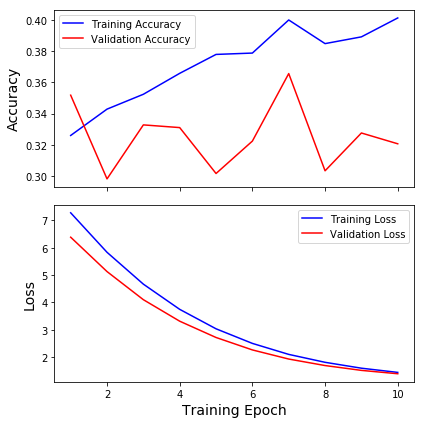

[io] Figure saved as results/model0A/model0A_keras_history  09-18-2019 20-15-23.png


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------

- Evaluating Training Data:
2884/2884 [==============================] - 2s 665us/step
    - Accuracy:0.3880
    - Loss:1.3742

- Evaluating Test Data:
509/509 [==============================] - 0s 554us/step
    - Accuracy:0.3360
    - Loss:1.3910

------------------------------------------------------------------------------------------
	CLASSIFICATION REPORT:
------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.33      0.48      0.39       164
           1       0.34      0.41      0.37       172
           2       0.34      0.12      0.18       173

   micro avg       0.34      0.34      0

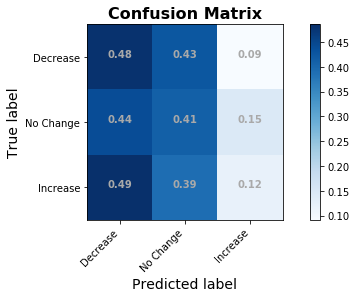

In [28]:
## set params
num_epochs = 10
validation_split = 0.2

clock = bs.Clock()
clock.tic()
dashes = '---'*20
print(f"{dashes}\n\tFITTING MODEL:\n{dashes}")

history0 = model0.fit(X_train, y_train, 
                      epochs=num_epochs,
                      verbose=True, 
                      validation_split=validation_split,
                      batch_size=300,
                      callbacks=callbacks)

clock.toc()

cm_fname = file_dict['model_0A']['fig_conf_mat.ext']
hist_fname = file_dict['model_0A']['fig_keras_history.ext']
summary_fname = file_dict['model_0A']['model_summary']

df_class_report0A,fig0A=ji.evaluate_classification(model0,history0,
                                                   X_train, X_test,
                                                   y_train, y_test, 
                                                   report_as_df=False,
                                                   binary_classes=False,
                                                   conf_matrix_classes=['Decrease','No Change','Increase'],
                                                   normalize_conf_matrix=True, 
                                                   save_history=True, history_filename=hist_fname,
                                                   save_conf_matrix_png=True, conf_mat_filename=cm_fname,
                                                   save_summary=True,summary_filename=summary_fname)

In [29]:
save_me_as_model_0A=True
save_me_as_pred_nlp = False

ji.reload(ji)
if save_me_as_pred_nlp:
    model_key='nlp_model_for_predictions'

elif save_me_as_model_0A:
    model_key='model_0A'    
    
filename = file_dict[model_key]['base_filename']
nlp_files = ji.save_model_weights_params(model0,check_if_exists=True,auto_increment_name=True, 
                                         auto_filename_suffix=True,filename_prefix=filename)

file_dict[model_key]['output_filenames'] = nlp_files

ji.update_file_directory(file_dict)

Model saved as models/NLP/nlp_model0A__09-18-2019_0815pm.json
Weights saved as models/NLP/nlp_model0A__09-18-2019_0815pm_weights.h5
Model configuration table saved as models/NLP/nlp_model0A__09-18-2019_0815pm_model_layers.xlsx
[i]filename_directory updated, filename='data/filename_dictionary.json'


### Model 0A Summary
Our model had difficulty classifying tweets by `delta_price`, but did perform better than chance (36% accuracy vs chance=33%). We will next attempt to use another type of recurrent-neural-network layer, the Gated Rectifier Unit (GRU).

## Model 0B

In [30]:
## GRU Model
from keras import models, layers, optimizers, regularizers
model0B = models.Sequential()

## Get and add embedding_layer
embedding_layer = ji.make_keras_embedding_layer(wv, X_train)
model0B.add(embedding_layer)

model0B.add(layers.SpatialDropout1D(0.3))
model0B.add(layers.GRU(units=100, dropout=0.3, recurrent_dropout=0.2,return_sequences=True)) 
model0B.add(layers.GRU(units=100, dropout=0.3, recurrent_dropout=0.2))

# model0.add(layers.Dense(units=50, activation='relu'))#, activation='tan' # activation='relu'))#removed 08/21
model0B.add(layers.Dense(3, activation='softmax'))

model0B.compile(loss='categorical_crossentropy',optimizer="adam",metrics=['acc'])#,'val_acc'])#, callbacks=callbacks)
model0B.summary()

embedding_matrix.shape = (5217, 300)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (None, 35, 300)           1565100   
_________________________________________________________________
spatial_dropout1d_1 (Spatial (None, 35, 300)           0         
_________________________________________________________________
gru_1 (GRU)                  (None, 35, 100)           120300    
_________________________________________________________________
gru_2 (GRU)                  (None, 100)               60300     
_________________________________________________________________
dense_2 (Dense)              (None, 3)                 303       
Total params: 1,746,003
Trainable params: 180,903
Non-trainable params: 1,565,100
_________________________________________________________________


--- CLOCK STARTED @:    09/18/19 - 08:15:30 PM --- 
Train on 2595 samples, validate on 289 samples
Epoch 1/10
2595/2595 [==============================] - 4s 1ms/step - loss: 1.1093 - acc: 0.3287 - val_loss: 1.1046 - val_acc: 0.3322
Epoch 2/10
2595/2595 [==============================] - 2s 918us/step - loss: 1.0953 - acc: 0.3638 - val_loss: 1.1123 - val_acc: 0.3010
Epoch 3/10
2595/2595 [==============================] - 3s 1ms/step - loss: 1.0934 - acc: 0.3792 - val_loss: 1.1132 - val_acc: 0.2872
Epoch 4/10
2595/2595 [==============================] - 2s 940us/step - loss: 1.0868 - acc: 0.3938 - val_loss: 1.1124 - val_acc: 0.3149
Epoch 5/10
2595/2595 [==============================] - 3s 1ms/step - loss: 1.0871 - acc: 0.3915 - val_loss: 1.1190 - val_acc: 0.3183
Epoch 6/10
2595/2595 [==============================] - 3s 971us/step - loss: 1.0845 - acc: 0.3908 - val_loss: 1.1239 - val_acc: 0.3114
Epoch 7/10
2595/2595 [==============================] - 2s 941us/step - loss: 1.0813 - acc:

Lap #,Start Time,Duration,Label
TOTAL,09/18/19 - 08:15:30 PM,"0 min, 27.076 sec",--


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


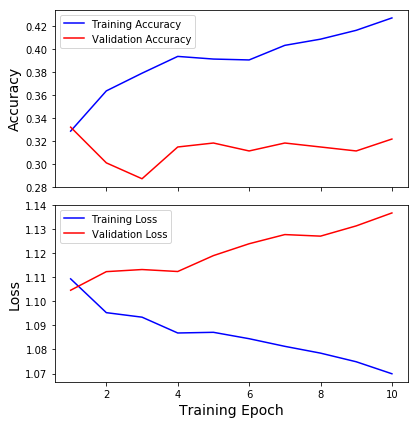

[io] Figure saved as results/model0B/model0B_keras_history  09-18-2019 20-15-57.png


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------

- Evaluating Training Data:
2884/2884 [==============================] - 2s 521us/step
    - Accuracy:0.4345
    - Loss:1.0619

- Evaluating Test Data:
509/509 [==============================] - 0s 466us/step
    - Accuracy:0.3497
    - Loss:1.1108

------------------------------------------------------------------------------------------
	CLASSIFICATION REPORT:
------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.37      0.37      0.37       164
           1       0.36      0.38      0.37       172
           2       0.32      0.29      0.31       173

   micro avg       0.35      0.35      0

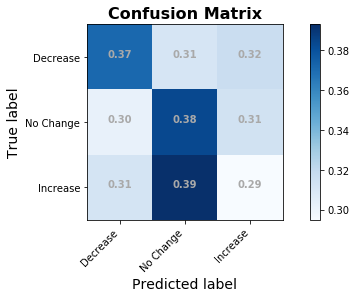

In [31]:
num_epochs = 10

clock = bs.Clock()
clock.tic()
historyB = model0B.fit(X_train, y_train, epochs=num_epochs, verbose=True, validation_split=0.1,
                     batch_size=300)#, class_weight=class_weight)#callbacks=callbacks,, validation_data=(X_val))
clock.toc()


model_key = "model_0B"
cm_fname = file_dict[model_key]['fig_conf_mat.ext']
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

df_class_report0B, fig0B  = ji.evaluate_classification(model0B, historyB, 
                           X_train, X_test, y_train,y_test,report_as_df=False,
                           conf_matrix_classes=['Decrease','No Change','Increase'],
                           binary_classes=False, normalize_conf_matrix=True, 
                           save_history=True, history_filename=hist_fname, 
                           save_conf_matrix_png=True, conf_mat_filename=cm_fname,
                           save_summary=True,summary_filename=summary_fname)

In [32]:
save_me_as_model_0B=True
save_me_as_pred_nlp = False

ji.reload(ji)
if save_me_as_pred_nlp:
    model_key='nlp_model_for_predictions'

elif save_me_as_model_0B:
    model_key='model_0B'    
    
filename = file_dict[model_key]['base_filename']
nlp_files = ji.save_model_weights_params(model0B,check_if_exists=True,auto_increment_name=True, 
                                         auto_filename_suffix=True,filename_prefix=filename)

file_dict[model_key]['output_filenames'] = nlp_files

ji.update_file_directory(file_dict)
# ji.dict_dropdown(file_dict)

Model saved as models/NLP/nlp_model0B__09-18-2019_0816pm.json
Weights saved as models/NLP/nlp_model0B__09-18-2019_0816pm_weights.h5
Model configuration table saved as models/NLP/nlp_model0B__09-18-2019_0816pm_model_layers.xlsx
[i]filename_directory updated, filename='data/filename_dictionary.json'


### Model 0B Summary

The GRU performed better than the LSTM model, with 39% validation accuracy.

In [33]:
ji.inspect_variables(locals(),show_how_to_delete=False)
del_me= ['one_hot_results','nlp_df','text_data']#list of variable names
for me in del_me:    
    try: 
        exec(f'del {me}')
        print(f'del {me} succeeded')
    except:
        print(f'del {me} failed')
        continue

,type,size
variable,,
twitter_df,DataFrame,20917564
nlp_df,DataFrame,17172586
df_tokenize,DataFrame,8545366
df_sampled,DataFrame,4470748
text_data,Series,724328
X,ndarray,475132
delta_price,Series,435832
keep_idx,Series,411602
X_train,ndarray,403872


#[i] set `print_names=True` for var names to copy/paste.
---------------------------------------------
del one_hot_results failed
del nlp_df succeeded
del text_data succeeded


# FORECASTING STOCK MARKET PRICE

## Loading & Processing Stock Data (SCRUB)

In [34]:
# DISPLAY CODE TO BE USED BELOW TO LOAD AND PROCESS STOCK DATA
functions_used=[ji.load_processed_stock_data, # This script combines the oriignal 4 used:
                ji.load_raw_stock_data_from_txt,
                ji.set_timeindex_freq,ji.custom_BH_freq,
               ji.get_technical_indicators]

ji.ihelp_menu(functions_used)
ji.save_ihelp_menu_to_file(functions_used,'_stock_df_processing')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('load_pr…

Output()

Functions saved as readme_resources/ihelp_outputs/_stock_df_processing.md


## Model 1: Using Price as only feature

### Choosing Appropriate Metrics for Time Series Forecasting

- Due to the estimation of price being a precise regression, accuracy will not be an appropriate metric for judging model performance. 
 - e.g. if the price was \\$ 114.23 and our model predicted \\$ 114.25, our accuracy is 0.<br><br>

- **Thiel's U:**
    - [Source of Equation/Explanation of Metric](https://docs.oracle.com/cd/E57185_01/CBREG/ch06s02s03s04.html)
    - $ U = \sqrt{\frac{\sum_{t=1 }^{n-1}\left(\frac{\bar{Y}_{t+1} - Y_{t+1}}{Y_t}\right)^2}{\sum_{t=1 }^{n-1}\left(\frac{Y_{t+1} - Y_{t}}{Y_t}\right)^2}}$


|Thiel's U Value | Interpretation |
| --- | --- |
| <1 | Forecasting is better than guessing| 
| 1 | Forecasting is about as good as guessing| 
|>1 | Forecasting is worse than guessing|

In [35]:
fname = file_dict['stock_df']['raw_csv_file']
raw_stock_df = ji.load_raw_stock_data_from_txt(filename = fname, verbose=2)

[i] Loading data/IVE_bidask1min_08_23_2019.csv...

[i] Exlcuding data earlier than 2016-12-01.
[i] Cleaning 0 values:
	 -replaced 12 zeroes in "BidClose" with np.nan ...".
	- dropping null values (`fill_or_drop_null`).
[i] Converting the datetimeindex to `freq` "CBH"
	- addressing resulting null values using fill_method ffill...
------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 09:30:00 -- to -- 2019-08-23 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,date_time_index,Date,Time,BidOpen,BidHigh,BidLow,BidClose,AskOpen,AskHigh,AskLow,AskClose,filled_timebin
date_time_index,,,,,,,,,,,,
2016-12-01 09:30:00,2016-12-01 09:30:00,12/01/2016,09:30,93.78,93.99,93.78,93.95,94.05,94.05,93.97,94.04,False
2016-12-01 10:30:00,2016-12-01 10:30:00,12/01/2016,10:30,94.16,94.16,94.09,94.1,94.17,94.17,94.1,94.11,False
2016-12-01 11:30:00,2016-12-01 11:30:00,12/01/2016,11:30,94.16,94.17,94.15,94.17,94.17,94.18,94.16,94.18,False
2016-12-01 12:30:00,2016-12-01 12:30:00,12/01/2016,12:30,94.21,94.21,94.21,94.21,94.22,94.22,94.22,94.22,False
2016-12-01 13:30:00,2016-12-01 13:30:00,12/01/2016,13:30,93.96,93.96,93.96,93.96,93.97,93.97,93.97,93.97,False


In [36]:
fig = ji.plotly_time_series(raw_stock_df, y_col='BidClose',as_figure=True)
stock_df = ji.get_technical_indicators(raw_stock_df,make_price_from='BidClose')
del raw_stock_df

# SELECT DESIRED COLUMNS
stock_df = stock_df[[
    'price','ma7','ma21','26ema','12ema','MACD','20sd',
    'upper_band','lower_band','ema','momentum']]

# Make stock_price for twitter functions
stock_df.dropna(inplace=True)
ji.index_report(stock_df)
display(stock_df.head(3))

------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-29 15:30:00 -- to -- 2019-08-23 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2016-12-29 15:30:00,96.27,96.864898,96.277007,96.573856,96.730494,0.156639,1.002051,98.281110,94.272904,96.263988,89.27
2016-12-30 09:30:00,96.38,96.850204,96.293537,96.571218,96.721997,0.150779,0.980655,98.254848,94.332227,96.341329,89.38
2016-12-30 10:30:00,96.21,96.831633,96.307891,96.566317,96.709593,0.143275,0.959724,98.227340,94.388442,96.253776,89.21


In [37]:
func_list = [ji.train_test_split_by_last_days,
           ji.make_scaler_library,
           ji.transform_cols_from_library,
           ji.make_train_test_series_gens]
ihelp_menu(func_list)
ji.save_ihelp_menu_to_file(func_list,'_stock_data_prep_for_modeling')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('train_t…

Output()

Functions saved as readme_resources/ihelp_outputs/_stock_data_prep_for_modeling.md


In [38]:
## SPECIFY # OF TRAINING TEST DAYS 
num_test_days=10
num_train_days= 260
### SPECIFY Number of days included in each X_sequence (each prediction)
days_for_x_window=1

# Calculate number of rows to bin for x_windows
periods_per_day = ji.get_day_window_size_from_freq( stock_df, ji.custom_BH_freq() )


## Get the number of rows for x_window 
x_window = periods_per_day * days_for_x_window#data_params['days_for_x_window'] 
print(f'X_window size = {x_window} -- ({days_for_x_window} day(s) * {periods_per_day} rows/day)\n')

## Train-test-split by the # of days
df_train, df_test = ji.train_test_split_by_last_days(stock_df,
                                                     periods_per_day =periods_per_day, 
                                                     num_test_days   = num_test_days,
                                                     num_train_days  = num_train_days,
                                                     verbose=1, iplot=True)

X_window size = 7 -- (1 day(s) * 7 rows/day)

training dates:	2018-08-13 09:30:00 	 2019-08-09 15:30:00 = 1820 rows
test dates:	2019-08-09 15:30:00 	 2019-08-23 14:30:00 = 70 rows


In [39]:
###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
display(df_train.head(2).style.set_caption('df_train - pre-scaling'))

scaler_library, df_train = ji.make_scaler_library(df_train, transform=True, verbose=1)

df_test = ji.transform_cols_from_library(df_test, col_list=None,
                                         scaler_library=scaler_library,
                                         inverse=False)
display(df_train.head(2).style.set_caption('df_train - post-scaling'))

# Show transformed dataset
# display( df_train.head(2).round(3).style.set_caption('training data - scaled'))

# Create timeseries generators
train_generator, test_generator = ji.make_train_test_series_gens( 
    df_train['price'], df_test['price'], 
    x_window=x_window,n_features=1,batch_size=1, verbose=0)

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2018-08-13 09:30:00,111.45,112,111.015,110.812,111.623,0.810437,0.991697,112.998,109.032,111.436,104.45
2018-08-13 10:30:00,111.44,112.012,111.028,110.819,111.618,0.799279,0.983083,112.995,109.062,111.439,104.44


[i] Using all columns...


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2018-08-13 09:30:00,0.671572,0.667684,0.589808,0.55856,0.622105,0.816034,0.130094,0.455239,0.656501,0.66823,0.671572
2018-08-13 10:30:00,0.671185,0.668222,0.590528,0.558976,0.621886,0.813823,0.128215,0.455013,0.657787,0.668345,0.671185


In [40]:
from keras.models import Sequential
from keras import optimizers
from keras.layers import Bidirectional, Dense, LSTM, Dropout
from keras.regularizers import l2

# Specifying input shape (size of samples, rank of samples?)
n_input = x_window
n_features = 1 # just stock Price

print(f'input shape: ({n_input},{n_features})')
input_shape=(n_input, n_features)

# Create model architecture
model1 = Sequential()
model1.add(LSTM(units=50, input_shape =input_shape,return_sequences=True))#,kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
model1.add(LSTM(units=50, activation='relu'))
model1.add(Dense(1))

model1.compile(loss=ji.my_rmse, metrics=['acc'],
              optimizer=optimizers.Nadam())

display(model1.summary())

input shape: (7,1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_2 (LSTM)                (None, 7, 50)             10400     
_________________________________________________________________
lstm_3 (LSTM)                (None, 50)                20200     
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 51        
Total params: 30,651
Trainable params: 30,651
Non-trainable params: 0
_________________________________________________________________


None

------------------------------------------------------------
	FITTING MODEL:
------------------------------------------------------------
--- CLOCK STARTED @:    09/18/19 - 08:16:09 PM           Label:            --- 
Epoch 1/5
 - 28s - loss: 0.0385 - acc: 0.0011
Epoch 2/5
 - 23s - loss: 0.0260 - acc: 0.0011
Epoch 3/5
 - 24s - loss: 0.0223 - acc: 0.0011
Epoch 4/5
 - 23s - loss: 0.0183 - acc: 0.0011
Epoch 5/5
 - 23s - loss: 0.0154 - acc: 0.0011
--- TOTAL DURATION   =  2 min, 1.616 sec --- 


Lap #,Start Time,Duration,Label
TOTAL,09/18/19 - 08:16:09 PM,"2 min, 1.616 sec",


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


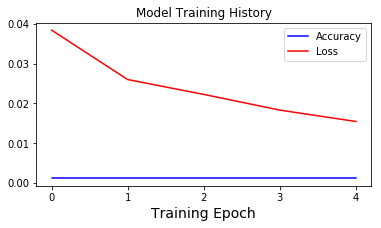

[io] Figure saved as results/model1/model1_keras_history  09-18-2019 20-18-11.png


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------
Evaluating Train Generator:
1813/1813 [==============================] - 4s 2ms/step
    - Accuracy:0.0011
    - Loss:0.0128
Evaluating Test Generator:
63/63 [==============================] - 0s 2ms/step
    - Accuracy:0.0000
    - Loss:0.0184


Metric,Value
R Squared,0.706
Root Mean Squared Error,0.026
Thiel's U,1.126


In [41]:
## FIT MODEL
dashes = '---'*20
print(f"{dashes}\n\tFITTING MODEL:\n{dashes}")

## set params
epochs=5

# override keras warnings
ji.quiet_mode(True,True,True)

# Instantiating clock timer
clock = bs.Clock()
clock.tic('')

# Fit the model
history = model1.fit_generator(train_generator,
                               epochs=epochs,
                               verbose=2, 
                               use_multiprocessing=True,
                               workers=3)

clock.toc('')


model_key = "model_1"
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

# eval_results = ji.evaluate_model_plot_history(model1, train_generator, test_generator)
ji.evaluate_regression_model(model1,history,
                             train_generator=train_generator,
                             test_generator=test_generator,
                            true_test_series=df_test['price'],
                            true_train_series =df_train['price'],
                             save_history=True,history_filename=hist_fname,
                             save_summary=True, summary_filename=summary_fname)

In [42]:
## Get true vs pred data as a dataframe and iplot
df_model1 = ji.get_model_preds_df(model1, 
                                  test_generator = test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  include_train_data=True,
                                  inverse_tf = True, 
                                  scaler = scaler_library['price'],
                                  preds_from_gen = True, 
                                  preds_from_train_preds = True, 
                                  preds_from_test_preds = True,
                                  iplot = True, iplot_title='Model 1: True Vs Predicted S&P 500 Price',
                                  verbose=0)
    
# Get evaluation metrics
df_results1, dfs_results1, df_shifted1 =\
ji.compare_eval_metrics_for_shifts(df_model1['true_test_price'],
                                   df_model1['pred_from_gen'],
                                   shift_list=np.arange(-4,4,1),
                                   true_train_series_to_add=df_model1['true_train_price'],
                                   display_results=True,
                                   display_U_info=True,
                                   return_results=True,
                                   return_styled_df=True,
                                   return_shifted_df=True)

[i] Using all columns...


<IPython.core.display.Latex object>

|Thiel's U Value | Interpretation |
    | --- | --- |
    | <1 | Forecasting is better than guessing| 
    | 1 | Forecasting is about as good as guessing| 
    |>1 | Forecasting is worse than guessing| 


Pred Shifted,R^2,RMSE,U
-4,0.4679,0.9046,1.515
-3,0.567,0.8124,1.19
-2,0.7045,0.671,1.1215
-1,0.9529,0.2693,0.4476
0,0.7059,0.6745,1.1352
1,0.5155,0.871,1.4567
2,0.2878,1.0608,2.0986
3,0.0918,1.1858,2.4473


In [43]:
save_model=True
ji.save_model_dfs(file_dict, 'model_1',df_model1,dfs_results1,df_shifted1)

filename_prefix = file_dict['model_1']['base_filename']
if save_model ==True:
    model_1_output_files = ji.save_model_weights_params(model1,
                                 filename_prefix=filename_prefix,
                                 auto_increment_name=True,
                                 auto_filename_suffix=True, 
                                 suffix_time_format='%m-%d-%y_%I%M%p',
                                 save_model_layer_config_xlsx=True)

[i] df_model saved as results/model1/model1_df_model_true_vs_preds.csv
Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               

[i] df_results saved as results/model1/model1_df_results.xlsx
[i] df_shifted saved as results/model1/model1_df_shifted.csv
Model saved as models/stocks/model1___09-18-19_0818pm.json
Weights saved as models/stocks/model1___09-18-19_0818pm_weights.h5
Model configuration table saved as models/stocks/model1___09-18-19_0818pm_model_layers.xlsx


### Model 1 Summary

- Using Stock Price alone and with a prediction time-shift of -1, we achieved:
    - $R^2$ value of 0.95
    - RMSE value of 0.2693
    - Thiel's $U$ value of 0.4476
- This means our first model can explain 95% of the variance in the data ($R^2$) and that our model performed significantly better than guessing (Thiel's U value <1.0)

## Model 2: Stock Price + Technical Indicators

### Technical Indicator Details

In [44]:
# SELECT DESIRED COLUMNS
stock_df = stock_df[[
    'price','ma7','ma21','26ema','12ema','MACD','20sd',
    'upper_band','lower_band','ema','momentum']]

# Make stock_price for twitter functions
stock_df.dropna(inplace=True)
ji.index_report(stock_df)
display(stock_df.head(3))

------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-29 15:30:00 -- to -- 2019-08-23 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2016-12-29 15:30:00,96.27,96.864898,96.277007,96.573856,96.730494,0.156639,1.002051,98.281110,94.272904,96.263988,89.27
2016-12-30 09:30:00,96.38,96.850204,96.293537,96.571218,96.721997,0.150779,0.980655,98.254848,94.332227,96.341329,89.38
2016-12-30 10:30:00,96.21,96.831633,96.307891,96.566317,96.709593,0.143275,0.959724,98.227340,94.388442,96.253776,89.21


In [45]:
fig =ji.plotly_technical_indicators(stock_df,figsize=(900,500))

1. **7 and 21 day moving averages**
```python
df['ma7'] df['price'].rolling(window = 7 ).mean() #window of 7 if daily data
df['ma21'] df['price'].rolling(window = 21).mean() #window of 21 if daily data
```    
2. **MACD(Moving Average Convergence Divergence)**

> Moving Average Convergence Divergence (MACD) is a trend-following momentumindicator that shows the relationship between two moving averages of a security’s price. The MACD is calculated by subtracting the 26-period Exponential Moving Average (EMA) from the 12-period EMA.

>The result of that calculation is the MACD line. A nine-day EMA of the MACD, called the "signal line," is then plotted on top of the MACD line, which can function as a trigger for buy and sell signals. 

> Traders may buy the security when the MACD crosses above its signal line and sell - or short - the security when the MACD crosses below the signal line. Moving Average Convergence Divergence (MACD) indicators can be interpreted in several ways, but the more common methods are crossovers, divergences, and rapid rises/falls.  - _[from Investopedia](https://www.investopedia.com/terms/m/macd.asp)_

```python
df['ewma26'] = pd.ewma(df['price'], span=26)
df['ewma12'] = pd.ewma(df['price'], span=12)
df['MACD'] = (df['12ema']-df['26ema'])
```
3. **Exponentially weighted moving average**
```python
dataset['ema'] = dataset['price'].ewm(com=0.5).mean()
```

4. **Bollinger bands**
    > "Bollinger Bands® are a popular technical indicators used by traders in all markets, including stocks, futures and currencies. There are a number of uses for Bollinger Bands®, including determining overbought and oversold levels, as a trend following tool, and monitoring for breakouts. There are also some pitfalls of the indicators. In this article, we will address all these areas."
> Bollinger bands are composed of three lines. One of the more common calculations of Bollinger Bands uses a 20-day simple moving average (SMA) for the middle band. The upper band is calculated by taking the middle band and adding twice the daily standard deviation, the lower band is the same but subtracts twice the daily std. - _[from Investopedia](https://www.investopedia.com/trading/using-bollinger-bands-to-gauge-trends/)_

    - Boilinger Upper Band:<br>
    $BOLU = MA(TP, n) + m * \sigma[TP, n ]$<br><br>
    - Boilinger Lower Band<br>
    $ BOLD = MA(TP,n) - m * \sigma[TP, n ]$
    - Where:
        - $MA$  = moving average
        - $TP$ (typical price) = $(High + Low+Close)/ 3$
        - $n$ is number of days in smoothing period
        - $m$ is the number of standard deviations
        - $\sigma[TP, n]$ = Standard Deviations over last $n$ periods of $TP$

```python
# Create Bollinger Bands
dataset['20sd'] = pd.stats.moments.rolling_std(dataset['price'],20)
dataset['upper_band'] = dataset['ma21'] + (dataset['20sd']*2)
dataset['lower_band'] = dataset['ma21'] - (dataset['20sd']*2)
```


5. **Momentum**
> "Momentum is the rate of acceleration of a security's price or volume – that is, the speed at which the price is changing. Simply put, it refers to the rate of change on price movements for a particular asset and is usually defined as a rate. In technical analysis, momentum is considered an oscillator and is used to help identify trend lines." - _[from Investopedia](https://www.investopedia.com/articles/technical/081501.asp)_

    - $ Momentum = V - V_x$
    - Where:
        - $ V $ = Latest Price
        - $ V_x $ = Closing Price
        - $ x $ = number of days ago

```python
# Create Momentum
dataset['momentum'] = dataset['price']-1
```

In [46]:
## SPECIFY # OF TRAINING TEST DAYS 
num_test_days=20
num_train_days=260
### SPECIFY Number of days included in each X_sequence (each prediction)
days_for_x_window=1

# Calculate number of rows to bin for x_windows
periods_per_day = ji.get_day_window_size_from_freq( stock_df, ji.custom_BH_freq() )

## Get the number of rows for x_window 
x_window = periods_per_day * days_for_x_window#data_params['days_for_x_window'] 
print(f'X_window size = {x_window} -- ({days_for_x_window} day(s) * {periods_per_day} rows/day)\n')

## Train-test-split by the # of days
df_train, df_test = ji.train_test_split_by_last_days(stock_df,
                                                     periods_per_day =periods_per_day, 
                                                     num_test_days   = num_test_days,
                                                     num_train_days  = num_train_days,
                                                     verbose=1, iplot=True)

X_window size = 7 -- (1 day(s) * 7 rows/day)

training dates:	2018-07-30 09:30:00 	 2019-07-26 15:30:00 = 1820 rows
test dates:	2019-07-26 15:30:00 	 2019-08-23 14:30:00 = 140 rows


In [47]:
###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
display(df_train.head(2).style.set_caption('df_train - pre-scaling'))

scaler_library, df_train = ji.make_scaler_library(df_train, transform=True, verbose=1)

df_test = ji.transform_cols_from_library(df_test, col_list=None,
                                         scaler_library=scaler_library,
                                         inverse=False)
display(df_train.head(2).style.set_caption('df_train - post-scaling'))

# Show transformed dataset
# display( df_train.head(2).round(3).style.set_caption('training data - scaled'))

# Create timeseries generators
train_generator, test_generator = ji.make_train_test_series_gens( 
    df_train['price'], df_test['price'], 
    x_window=x_window,n_features=1,batch_size=1, verbose=0)

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2018-07-30 09:30:00,111.25,110.448,109.44,109.536,110.23,0.693965,1.14844,111.737,107.144,111.215,104.25
2018-07-30 10:30:00,111.82,110.488,109.466,109.561,110.267,0.706421,1.14385,111.753,107.178,111.618,104.82


[i] Using all columns...


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2018-07-30 09:30:00,0.666148,0.617301,0.516463,0.495036,0.562494,0.792956,0.164286,0.445026,0.585065,0.663063,0.666148
2018-07-30 10:30:00,0.688302,0.619186,0.517848,0.496594,0.564443,0.795424,0.163285,0.446135,0.586529,0.678947,0.688302


In [48]:
## Make new time series generators with all stock_indicators for X_sequences
train_generator, test_generator = ji.make_train_test_series_gens(
    train_data_series=df_train,
    test_data_series=df_test,
    y_cols='price',
    x_window=x_window,
    n_features=len(df_train.columns),
    batch_size=1, verbose=1)

Given the Array: 	(with shape=(1, 7, 11)) 
[0.66614846 0.61730082 0.51646254 0.49503602 0.56249375 0.79295628
 0.16428554 0.44502585 0.58506506 0.66306318 0.66614846 0.68830159
 0.61918585 0.51784827 0.49659368 0.56444251 0.79542437 0.16328467
 0.44613505 0.58652949 0.67894746 0.68830159 0.68519238 0.62082583
 0.51908833 0.49807976 0.56624739 0.79757232 0.16180274 0.44675646
 0.58806872 0.6821407  0.68519238 0.68519238 0.62242811 0.52034707
 0.4995496  0.5680098  0.79961026 0.15950902 0.44688737 0.58993912
 0.68320512 0.68519238 0.68519238 0.62403039 0.52165436 0.50100338
 0.56973075 0.80154143 0.15653706 0.44664992 0.59211177 0.68355992
 0.68519238 0.68480373 0.62545359 0.52300647 0.50243445 0.57139895
 0.80334403 0.15508759 0.44743282 0.59372517 0.6834155  0.68480373
 0.67353284 0.62682966 0.52431377 0.50365215 0.57267257 0.80432292
 0.15271429 0.44757441 0.59566426 0.67574936 0.67353284]

Predict this y: 
 [[0.6898562]]


In [49]:
# Create keras model from model_params
import functions_combined_BEST as ji
from keras.models import Sequential
from keras.layers import Bidirectional, Dense, LSTM, Dropout
from IPython.display import display
from keras.regularizers import l2

# Specifying input shape (size of samples, rank of samples?)
n_input = x_window 
n_features = len(df_train.columns) # Using stock_price and technical indicators

print(f'input shape: ({n_input},{n_features}')
input_shape=(n_input, n_features)

# Create model architecture
model2 = Sequential()
model2.add(LSTM(units=50, input_shape =input_shape,return_sequences=True))#,  kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
# model2.add(Dropout(0.2))
model2.add(LSTM(units=50, activation='relu'))
model2.add(Dense(1))

model2.compile(loss=ji.my_rmse, metrics=['acc',ji.my_rmse],
              optimizer=optimizers.Nadam())

display(model2.summary())

input shape: (7,11
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_4 (LSTM)                (None, 7, 50)             12400     
_________________________________________________________________
lstm_5 (LSTM)                (None, 50)                20200     
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 51        
Total params: 32,651
Trainable params: 32,651
Non-trainable params: 0
_________________________________________________________________


None

------------------------------------------------------------
	FITTING MODEL:
------------------------------------------------------------ 

--- CLOCK STARTED @:    09/18/19 - 08:18:31 PM           Label:            --- 
Epoch 1/5
1813/1813 [==============================] - 20s 11ms/step - loss: 0.0454 - acc: 0.0011 - my_rmse: 0.0454
Epoch 2/5
1813/1813 [==============================] - 18s 10ms/step - loss: 0.0272 - acc: 0.0011 - my_rmse: 0.0272
Epoch 3/5
1813/1813 [==============================] - 18s 10ms/step - loss: 0.0211 - acc: 0.0011 - my_rmse: 0.0211
Epoch 4/5
1813/1813 [==============================] - 18s 10ms/step - loss: 0.0171 - acc: 0.0011 - my_rmse: 0.0171
Epoch 5/5
1813/1813 [==============================] - 17s 10ms/step - loss: 0.0155 - acc: 0.0011 - my_rmse: 0.0155
--- TOTAL DURATION   =  1 min, 33.296 sec --- 


Lap #,Start Time,Duration,Label
TOTAL,09/18/19 - 08:18:31 PM,"1 min, 33.296 sec",


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


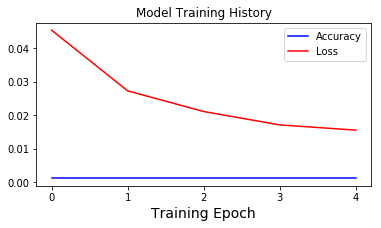

[io] Figure saved as results/model2/model2_keras_history  09-18-2019 20-20-05.png


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------
Evaluating Train Generator:
1813/1813 [==============================] - 4s 2ms/step
    - Accuracy:0.0011
    - Loss:0.0107
Evaluating Test Generator:
133/133 [==============================] - 0s 3ms/step
    - Accuracy:0.0000
    - Loss:0.0168


Metric,Value
R Squared,0.916
Root Mean Squared Error,0.024
Thiel's U,1.11


In [50]:
epochs=5

clock = bs.Clock()
print('---'*20)
print('\tFITTING MODEL:')
print('---'*20,'\n')     

# start the timer
clock.tic('')

# Fit the model
history = model2.fit_generator(train_generator,epochs=epochs) 
clock.toc('')

model_key = "model_2"
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

# eval_results = ji.evaluate_model_plot_history(model1, train_generator, test_generator)
ji.evaluate_regression_model(model2,history,
                             train_generator=train_generator,
                             test_generator=test_generator,
                            true_test_series=df_test['price'],
                            true_train_series =df_train['price'],
                             save_history=True,history_filename=hist_fname,
                             save_summary=True, summary_filename=summary_fname)

In [51]:
## Get true vs pred data as a dataframe and iplot
df_model2 = ji.get_model_preds_df(model2, 
                                  test_generator=test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  x_window=x_window,
                                  n_features=len(df_train.columns),
                                  scaler=scaler_library['price'],
                                  preds_from_gen=True, 
                                  inverse_tf=True,
                                  iplot=True,  iplot_title='Model 2: True Vs Predicted S&P 500 Price')

# Compare predictions if predictions timebins shifted
df_results2, dfs_results2, df_shifted2 =\
ji.compare_eval_metrics_for_shifts(df_model2['true_test_price'],
                                   df_model2['pred_from_gen'],
                                   shift_list=np.arange(-4,5,1),
                                   true_train_series_to_add=df_model2['true_train_price'],
                                   display_results=True,
                                   return_styled_df=True,
                                   display_U_info=False,
                                   return_shifted_df=True,
                                   return_results=True)

[i] Using all columns...


,true_train_price,true_test_price,pred_from_gen
2018-07-30 09:30:00,111.25,nan,nan
2018-07-30 10:30:00,111.82,nan,nan
2018-07-30 11:30:00,111.74,nan,nan


,true_train_price,true_test_price,pred_from_gen
2019-08-23 12:30:00,nan,113.11,113.22
2019-08-23 13:30:00,nan,112.72,113.294
2019-08-23 14:30:00,nan,112.91,112.825


Pred Shifted,R^2,RMSE,U
-4,0.7654,1.0442,1.8833
-3,0.83,0.8875,1.5733
-2,0.8753,0.7599,1.3409
-1,0.9844,0.269,0.4812
0,0.9156,0.626,1.1167
1,0.8415,0.8454,1.5119
2,0.7594,1.0317,1.843
3,0.6879,1.1618,2.0706
4,0.6027,1.2939,2.2989


In [87]:
##SAVING DFS
ji.save_model_dfs(file_dict,'model_2',
               df_model=df_model2,
              df_results=dfs_results2,
              df_shifted=df_shifted2)

[i] df_model saved as results/model2/model2_df_model_true_vs_preds.csv
Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               

[i] df_results saved as results/model2/model2_df_results.xlsx
[i] df_shifted saved as results/model2/model2_df_shifted.csv


In [88]:
df_results2, dfs_results2, df_shifted2 =\
ji.compare_eval_metrics_for_shifts(df_model2['true_test_price'],
                                   df_model2['pred_from_gen'],
                                   shift_list=np.arange(-4,5,1),
                                   true_train_series_to_add=df_model2['true_train_price'],
                                   display_results=True,
                                   return_styled_df=True,
                                   display_U_info=False,
                                   return_shifted_df=True,
                                   return_results=True)

Pred Shifted,R^2,RMSE,U
-4,0.7654,1.0442,1.8833
-3,0.83,0.8875,1.5733
-2,0.8753,0.7599,1.3409
-1,0.9844,0.269,0.4812
0,0.9156,0.626,1.1167
1,0.8415,0.8454,1.5119
2,0.7594,1.0317,1.843
3,0.6879,1.1618,2.0706
4,0.6027,1.2939,2.2989


### Model 2: Summary

- Using Stock Price plus technical indicators, and with a prediction time-shift of -1, we achieved:
    - $R^2$ value of 0.98
    - RMSE value of 0.269
    - Thiel's $U$ value of 0.4812
- This means our second model can explain \_\_% of the variance in the data ($R^2$) and that our model performed ~~significantly better~~ than guessing (Thiel's U value ~~<1.0~~)

- It is surprisng that the model's performance is so poor by adding the technical indicators.
    - Further investigation is required to understand why the $R^2$ value is negative. 

# COMBINING TWEET STATS, NLP CLASSIFICATION, AND MARKET DATA

In [54]:
# LOAD IN FULL STOCK DATASET using ClosingBig S&P500 WITH INDEX.FREQ=CBH
fname = file_dict['stock_df']['stock_df_with_indicators']
full_df = ji.load_processed_stock_data(processed_data_filename=fname)

# SELECT DESIRED COLUMNS
stock_df = full_df[[
    'price','ma7','ma21','26ema','12ema','MACD',
    '20sd','upper_band','lower_band','ema','momentum'
]]

stock_df.head()

stock_df['date_time'] = stock_df.index.to_series()
ji.index_report(stock_df)

stock_df.sort_index(inplace=True)
display(stock_df.head(2),stock_df.tail(2))
del full_df

>> File found. Loading data/_stock_df_with_technical_indicators.csv
------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-29 15:30:00 -- to -- 2019-08-23 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,date_time
date_time_index,,,,,,,,,,,,
2016-12-29 15:30:00,96.27,96.864898,96.277007,96.573856,96.730494,0.156639,1.002051,98.281110,94.272904,96.263988,89.27,2016-12-29 15:30:00
2016-12-30 09:30:00,96.38,96.850204,96.293537,96.571218,96.721997,0.150779,0.980655,98.254848,94.332227,96.341329,89.38,2016-12-30 09:30:00


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,date_time
date_time_index,,,,,,,,,,,,
2019-08-23 14:30:00,112.91,114.314694,115.539932,115.450784,114.740431,-0.710353,2.343498,120.226928,110.852936,112.921281,105.91,2019-08-23 14:30:00
2019-08-23 15:30:00,112.45,114.322857,115.494626,115.417989,114.686539,-0.731450,2.324805,120.144236,110.845016,112.607094,105.45,2019-08-23 15:30:00


In [55]:
## LOAD IN RAW TWITTER DATA, NO PROCESSING
twitter_df= ji.load_raw_twitter_file(filename='data/trumptwitterarchive_export_iphone_only__08_23_2019.csv',
                                     date_as_index=True,
                                     rename_map={'text': 'content', 'created_at': 'date'})
twitter_df = ji.check_twitter_df(twitter_df,text_col='content',remove_duplicates=True, remove_long_strings=True)


[io] Loading raw tweet text file: data/trumptwitterarchive_export_iphone_only__08_23_2019.csv
------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 14:37:57 -- to -- 2019-08-24 03:58:32
* Index Freq:
	None
------------------------------------------------------------
DUPLCATE COLUMNS REPORT:
------------------------------------------------------------
[i] No duplicate columns found.
	>> returning original df...
------------------------------------------------------------
	STRING LENGTH REPORT:	"content" column
------------------------------------------------------------
[i] Found 2 # of strings above cutoff of 400 chars.
	[i] Removed long strings. Rechecking final string column.

[i] Found 0 # of strings above cutoff of 400 chars.


,count,mean,std,min,25%,50%,75%,max
content,9320,167.556,77.5698,2,119,140,254,315


,source,content,date,retweet_count,favorite_count,is_retweet,id_str
date,,,,,,,
2016-12-01 14:37:57,Twitter for iPhone,My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southeastern United States. Stay safe!,2016-12-01 14:37:57,12077,65724,False,804333718999539712
2016-12-01 22:52:10,Twitter for iPhone,Heading to U.S. Bank Arena in Cincinnati Ohio for a 7pm rally. Join me! Tickets: https://t.co/HiWqZvHv6M,2016-12-01 22:52:10,5564,31256,False,804458095569158144


In [56]:
# MAKE TIME INTERVALS BASED ON BUSINESS HOUR START (09:30-10:30)
time_intervals= \
ji.make_time_index_intervals(stock_df,
                             col='date_time', 
                             closed='right',
                             return_interval_dicts=False) 


## USE THE TIME INDEX TO FILTER OUT TWEETS FROM THE HOUR PRIOR
twitter_df, bin_codes = ji.bin_df_by_date_intervals(twitter_df ,time_intervals)
stock_df, bin_codes_stock = ji.bin_df_by_date_intervals(stock_df, time_intervals, column='date_time')

## COLLAPSE DFs BY CODED BINS
twitter_grouped = ji.collapse_df_by_group_index_col(twitter_df,
                                                    group_index_col='int_bins',
                                                    drop_orig=True,
                                                    verbose=0)

stocks_grouped = ji.collapse_df_by_group_index_col(stock_df,
                                                    drop_orig=True,
                                                    group_index_col='int_bins', 
                                                  verbose=0)
display(twitter_grouped.head(2),stocks_grouped.head(2))

Columns content not in df
Columns date not in df


,source,date,is_retweet,id_str,int_times,int_bins,date_time_index,time_bin,num_per_bin,total_retweet_count,total_favorite_count,group_content
-1,"[Twitter for iPhone, Twitter for iPhone, Twitter for iPhone, Twitter for iPhone, Twitter for iPh...","[2016-12-01 14:37:57, 2016-12-01 22:52:10, 2016-12-02 02:45:18, 2016-12-03 19:09:40, 2016-12-03 ...","[False, False, False, False, False, False, False, False, False, False, False, False, False, Fals...","[804333718999539712, 804458095569158144, 804516764562374656, 805126876779913216, 805127720749383...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, ...",-1,"[2016-12-01T14:37:57.000000000, 2016-12-01T22:52:10.000000000, 2016-12-02T02:45:18.000000000, 20...",NaT,75,947671,3389984,My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...
5,Twitter for iPhone,2016-12-29 14:54:21,False,814484710025994241,"(2016-12-29 14:30:00, 2016-12-29 15:30:00]",5,2016-12-29T14:54:21.000000000,2016-12-29 14:30:00,1,11330,45609,My Administration will follow two simple rules: https://t.co/ZWk0j4H8Qy


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,date_time,int_times,int_bins,date_time_index,time_bin,num_per_bin
5,96.27,96.864898,96.277007,96.573856,96.730494,0.156639,1.002051,98.281110,94.272904,96.263988,89.27,2016-12-29 15:30:00,"(2016-12-29 14:30:00, 2016-12-29 15:30:00]",5,2016-12-29 15:30:00,2016-12-29 14:30:00,1
23,96.38,96.850204,96.293537,96.571218,96.721997,0.150779,0.980655,98.254848,94.332227,96.341329,89.38,2016-12-30 09:30:00,"(2016-12-30 08:30:00, 2016-12-30 09:30:00]",23,2016-12-30 09:30:00,2016-12-30 08:30:00,1


In [57]:
ihelp_menu(ji.merge_stocks_and_tweets)

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('merge_s…

Output()

In [58]:
## STOCKS AND TWEETS 
df_combined = ji.merge_stocks_and_tweets(stocks_grouped, 
                                      twitter_grouped,
                                      on='int_bins',how='left',
                                      show_summary=False)

In [59]:
ji.column_report(df_combined, as_df=True)

,column name,dtypes,# zeros,# null,% null,Notes
".iloc[:,i]",,,,,,
0,price,float64,0.0,0,0.00,
1,ma7,float64,0.0,0,0.00,
2,ma21,float64,0.0,0,0.00,
3,26ema,float64,0.0,0,0.00,
4,12ema,float64,0.0,0,0.00,
5,MACD,float64,0.0,0,0.00,
6,20sd,float64,0.0,0,0.00,
7,upper_band,float64,0.0,0,0.00,
8,lower_band,float64,0.0,0,0.00,


In [60]:
## Check for and address new null values
ji.check_null_small(df_combined);
cols_to_fill_zeros = ['num_tweets','total_retweet_count','total_favorite_count']
for col in cols_to_fill_zeros:
    idx_null = ji.find_null_idx(df_combined, column=col)
    df_combined.loc[idx_null,col] = 0

cols_to_fill_blank_str = ['group_content','source','tweet_times','is_retweet']
for col in cols_to_fill_blank_str:
    idx_null = ji.find_null_idx(df_combined, column=col)
    df_combined.loc[idx_null, col] = ""
ji.check_null_small(df_combined);



------------------------------
Columns with Null Values
------------------------------
source                  3500
is_retweet              3509
id_str                  3500
tweet_times             3500
num_tweets              3500
total_retweet_count     3500
total_favorite_count    3500
group_content           3500
dtype: int64




------------------------------
Columns with Null Values
------------------------------
id_str    3500
dtype: int64




In [61]:
fname = file_dict['df_combined']['pre_nlp']
df_combined.to_csv(fname)

In [62]:
## Add nlp
df_nlp = ji.full_twitter_df_processing(df_combined,'group_content',force=True)
ji.column_report(df_nlp, as_df=True)

[i] case_ratio calculated from content_min_clean before text to lowercase
[i] case->lower and punctuation removed from "content_min_clean" 
[i] stopped text column:  content_cleaned_stop
[i] tokenized stopped text column:  content_cleaned_stop_tokens
[i] lemmaztied columns: cleaned_stopped_lemmas


,column name,dtypes,# zeros,# null,% null,Notes
".iloc[:,i]",,,,,,
0,price,float64,0.0,0,0.00,
1,ma7,float64,0.0,0,0.00,
2,ma21,float64,0.0,0,0.00,
3,26ema,float64,0.0,0,0.00,
4,12ema,float64,0.0,0,0.00,
5,MACD,float64,0.0,0,0.00,
6,20sd,float64,0.0,0,0.00,
7,upper_band,float64,0.0,0,0.00,
8,lower_band,float64,0.0,0,0.00,


In [63]:
## Use case ratio null values as index to replace values
idx_null= ji.check_null_small(df_nlp,null_index_column='case_ratio')
df_nlp.loc[idx_null,'case_ratio'] = 0.0
ji.check_null_small(df_nlp)

## replace sentiment_class, set =-1
cols_to_replace_misleading_values = ['sentiment_class']
for col in cols_to_replace_misleading_values:
    df_nlp.loc[idx_null,col] = -1

## remap sentiment class
sent_class_mapper = {'neg':0, -1:1, 'pos':2}
df_nlp['sentiment_class'] = df_nlp['sentiment_class'].apply(lambda x: sent_class_mapper[x])

bool_cols_to_ints = ['has_tweets']
for col in bool_cols_to_ints:
    df_nlp[col] = df_nlp[col].apply(lambda x: 1 if x==True else 0)    



------------------------------
Columns with Null Values
------------------------------
id_str        3500
case_ratio    3506
dtype: int64




------------------------------
Columns with Null Values
------------------------------
id_str    3500
dtype: int64




In [64]:
ji.display_same_tweet_diff_cols(df_nlp.groupby('has_tweets').get_group(True),
                                columns=['group_content','content_min_clean','cleaned_stopped_lemmas'],as_md=True)

#### TWEET FROM 07-24-2017 13:30:00:

* **["group_content"] column:**<p><blockquote>***"So why aren't the Committees and investigators and of course our beleaguered A.G. looking into Crooked Hillarys crimes &amp; Russia relations?,Sleazy Adam Schiff the totally biased Congressman looking into "Russia" spends all of his time on television pushing the Dem loss excuse!,Republicans have a last chance to do the right thing on Repeal &amp; Replace after years of talking &amp; campaigning on it."***

* **["content_min_clean"] column:**<p><blockquote>***"so why aren t the committees and investigators and of course our beleaguered a g  looking into crooked hillarys crimes  amp  russia relations  sleazy adam schiff the totally biased congressman looking into  russia  spends all of his time on television pushing the dem loss excuse  republicans have a last chance to do the right thing on repeal  amp  replace after years of talking  amp  campaigning on it "***

* **["cleaned_stopped_lemmas"] column:**<p><blockquote>***"committee investigator course beleaguered g looking crooked hillary crime russia relation sleazy adam schiff totally biased congressman looking russia spends time television pushing dem loss excuse republican last chance right thing repeal replace year talking campaigning"***

In [65]:
ji.check_twitter_df(df_nlp,char_limit=61*350)
# get_floats = df_nlp['content_min_clean'].apply(lambda x: isinstance(x,float))

------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-29 15:30:00 -- to -- 2019-08-23 15:30:00
* Index Freq:
	None
------------------------------------------------------------
DUPLCATE COLUMNS REPORT:
------------------------------------------------------------
[i] No duplicate columns found.
	>> returning original df...
------------------------------------------------------------
	STRING LENGTH REPORT:	"content_min_clean" column
------------------------------------------------------------
[i] Found 0 # of strings above cutoff of 21350 chars.


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,date_time,int_tweets_for_stocks,int_bins,stock_times,source,is_retweet,id_str,tweet_times,num_tweets,total_retweet_count,total_favorite_count,group_content,has_tweets,has_stocks,has_both,has_RT,starts_RT,content_starts_RT,content_cleaned,content_min_clean,case_ratio,content_hashtags,hashtag_strings,content_mentions,mention_strings,content_cleaned_stop,content_cleaned_stop_tokens,cleaned_stopped_lemmas,sentiment_scores,compound_score,sentiment_class,neg,neu,pos
date_time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-12-29 15:30:00,96.27,96.8649,96.277,96.5739,96.7305,0.156639,1.00205,98.2811,94.2729,96.264,89.27,2016-12-29 15:30:00,"(2016-12-29 14:30:00, 2016-12-29 15:30:00]",5,2016-12-29 15:30:00,Twitter for iPhone,False,814484710025994241,2016-12-29 14:54:21,1,11330,45609,My Administration will follow two simple rules: https://t.co/ZWk0j4H8Qy,1,True,True,False,False,[],My Administration will follow two simple rules:,my administration will follow two simple rules,0.04167,[],,[],,administration follow two simple rules,"['administration', 'follow', 'two', 'simple', 'rules']",administration follow two simple rule,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}",0,2,0,1,0
2016-12-30 09:30:00,96.38,96.8502,96.2935,96.5712,96.722,0.150779,0.980655,98.2548,94.3322,96.3413,89.38,2016-12-30 09:30:00,"(2016-12-30 08:30:00, 2016-12-30 09:30:00]",23,2016-12-30 09:30:00,,,nan,,0,0,0,,0,True,False,False,False,[],,,0,[],,[],,,[],,"{'neg': 0.0, 'neu': 0.0, 'pos': 0.0, 'compound': 0.0}",0,1,0,0,0


In [66]:
fname =file_dict['df_combined']['post_nlp']
df_nlp.to_csv(fname)
# print(f'saved to {fname}')

### Loading in NLP Model for Predictions

In [67]:
def get_most_recent_filenames(full_filename,str_to_find=None):
    import os
    import time
    fparts = full_filename.split('/')
    folder = '/'.join(fparts[0:-1])
    name = fparts[-1]
    
    filelist = os.listdir(folder)

    mtimes = [['file','date modified']]
    for file in filelist:
        if str_to_find is None:
            mtimes.append([file, time.ctime(os.path.getmtime(folder+'/'+file))])
        elif str_to_find in file:
            mtimes.append([file, time.ctime(os.path.getmtime(folder+'/'+file))])
    res = bs.list2df(mtimes)
    res['date modified'] = pd.to_datetime(res['date modified'])
    res.set_index('date modified',inplace=True)
    res.sort_index(ascending=False, inplace=True)
    
    most_recent = res.iloc[0]
    import re
    re.compile(r'()')
    
    return    res

In [68]:
## Load the nlp model and weights with layers set trainable=False
base_fname = file_dict['nlp_model_for_predictions']['base_filename']
nlp_model,df_model_layers =  ji.load_model_weights_params(base_filename= base_fname,#'models/NLP/nlp_model0B__09-02-2019_0121pm',
                                        load_model_params=False,
                                        load_model_layers_excel=True,
                                        trainable=False)
## Load in Word2Vec model from earlier
w2v_model = io.load_word2vec(file_dict=file_dict)

Loaded models/best_final/nlp_classifier_model.json and loaded weights from models/best_final/nlp_classifier_model_weights.h5.
All model.layers.trainable set to False.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_10 (Embedding)     (None, 35, 300)           1803900   
_________________________________________________________________
spatial_dropout1d_9 (Spatial (None, 35, 300)           0         
_________________________________________________________________
lstm_11 (LSTM)               (None, 100)               160400    
_________________________________________________________________
dense_10 (Dense)             (None, 3)                 303       
Total params: 1,964,603
Trainable params: 0
Non-trainable params: 1,964,603
_________________________________________________________________


None

Note: Model must be compiled again to be used.
[i] Loading Word2Vec model from models/word2vec/word2vec_model.pkl


### Get Predictions for Hour-Binned Tweets

In [69]:
ihelp_menu([ji.get_tokenizer_and_text_sequences,
           ji.replace_embedding_layer])

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('get_tok…

Output()

In [70]:
## GET X_SEQUENES FOR BINNED TWEETS AND CREATE NEW EMBEDDING LAYER FOR THEIR SIZE
text_data=df_nlp['cleaned_stopped_lemmas']
tokenizer, X_sequences = ji.get_tokenizer_and_text_sequences(w2v_model,text_data)

new_nlp_model = ji.replace_embedding_layer(nlp_model,w2v_model,text_data,verbose=2)
new_nlp_model.summary()

------------------------------ 
 json_model['config']['layers'][0]:
	 batch_input_shape:  [None, 35]
	 input_dim:  6013
	 input_length: 35
------------ Dictionary Contents ------------


interactive(children=(Dropdown(description='dict_to_display', options={'class_name': 'Embedding', 'config': {'…

(num_rows_in_df, num_words_in_vocab)
(4838, 730)
embedding_matrix.shape = (5217, 300)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_3 (Embedding)      (None, 730, 300)          1565100   
_________________________________________________________________
spatial_dropout1d_9 (Spatial (None, 730, 300)          0         
_________________________________________________________________
lstm_11 (LSTM)               (None, 100)               160400    
_________________________________________________________________
dense_10 (Dense)             (None, 3)                 303       
Total params: 1,725,803
Trainable params: 0
Non-trainable params: 1,725,803
_________________________________________________________________


In [71]:
## GET PREDICTIONS FROM NEW MODEL
preds = new_nlp_model.predict_classes(X_sequences)
print(type(preds), preds.shape)
ji.check_y_class_balance(preds)

<class 'numpy.ndarray'> (4838,)

[i] class balance (%) for variable #0:


1    82.244729
0     9.673419
2     8.081852
Name: data 0, dtype: float64

In [72]:
## add to df
df_nlp['pred_classes_int'] = preds
mapper= {0:'neg',  1:'no_change', 2:'pos'}
df_nlp['pred_classes'] = df_nlp['pred_classes_int'].apply(lambda x: mapper[x])
display(df_nlp.head())

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,date_time,int_tweets_for_stocks,int_bins,stock_times,source,is_retweet,id_str,tweet_times,num_tweets,total_retweet_count,total_favorite_count,group_content,has_tweets,has_stocks,has_both,has_RT,starts_RT,content_starts_RT,content_cleaned,content_min_clean,case_ratio,content_hashtags,hashtag_strings,content_mentions,mention_strings,content_cleaned_stop,content_cleaned_stop_tokens,cleaned_stopped_lemmas,sentiment_scores,compound_score,sentiment_class,neg,neu,pos,pred_classes_int,pred_classes
date_time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-12-29 15:30:00,96.27,96.864898,96.277007,96.573856,96.730494,0.156639,1.002051,98.281110,94.272904,96.263988,89.27,2016-12-29 15:30:00,"(2016-12-29 14:30:00, 2016-12-29 15:30:00]",5,2016-12-29 15:30:00,Twitter for iPhone,False,814484710025994241,2016-12-29 14:54:21,1.0,11330.0,45609.0,My Administration will follow two simple rules: https://t.co/ZWk0j4H8Qy,1,True,True,False,False,[],My Administration will follow two simple rules:,my administration will follow two simple rules,0.04167,[],,[],,administration follow two simple rules,"[administration, follow, two, simple, rules]",administration follow two simple rule,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}",0.0,2,0.0,1.0,0.0,0,neg
2016-12-30 09:30:00,96.38,96.850204,96.293537,96.571218,96.721997,0.150779,0.980655,98.254848,94.332227,96.341329,89.38,2016-12-30 09:30:00,"(2016-12-30 08:30:00, 2016-12-30 09:30:00]",23,2016-12-30 09:30:00,,,NaN,,0.0,0.0,0.0,,0,True,False,False,False,[],,,0.00000,[],,[],,,[],,"{'neg': 0.0, 'neu': 0.0, 'pos': 0.0, 'compound': 0.0}",0.0,1,0.0,0.0,0.0,1,no_change
2016-12-30 10:30:00,96.21,96.831633,96.307891,96.566317,96.709593,0.143275,0.959724,98.227340,94.388442,96.253776,89.21,2016-12-30 10:30:00,"(2016-12-30 09:30:00, 2016-12-30 10:30:00]",24,2016-12-30 10:30:00,,,NaN,,0.0,0.0,0.0,,0,True,False,False,False,[],,,0.00000,[],,[],,,[],,"{'neg': 0.0, 'neu': 0.0, 'pos': 0.0, 'compound': 0.0}",0.0,1,0.0,0.0,0.0,1,no_change
2016-12-30 11:30:00,96.34,96.814286,96.322653,96.563255,96.700645,0.137390,0.938272,98.199196,94.446110,96.311259,89.34,2016-12-30 11:30:00,"(2016-12-30 10:30:00, 2016-12-30 11:30:00]",25,2016-12-30 11:30:00,,,NaN,,0.0,0.0,0.0,,0,True,False,False,False,[],,,0.00000,[],,[],,,[],,"{'neg': 0.0, 'neu': 0.0, 'pos': 0.0, 'compound': 0.0}",0.0,1,0.0,0.0,0.0,1,no_change
2016-12-30 12:30:00,96.25,96.794694,96.336531,96.559027,96.689742,0.130715,0.912397,98.161325,94.511736,96.270420,89.25,2016-12-30 12:30:00,"(2016-12-30 11:30:00, 2016-12-30 12:30:00]",26,2016-12-30 12:30:00,,,NaN,,0.0,0.0,0.0,,0,True,False,False,False,[],,,0.00000,[],,[],,,[],,"{'neg': 0.0, 'neu': 0.0, 'pos': 0.0, 'compound': 0.0}",0.0,1,0.0,0.0,0.0,1,no_change


## Model 3: Stock Price + Indicators + NLP Preds & Tweet Features

### Finalize colums for final model

In [73]:
df_combined = df_nlp

model_col_list = ['price', 'ma7', 'ma21', '26ema', '12ema', 'MACD', '20sd', 'upper_band','lower_band', 'ema', 'momentum',
                  'has_tweets','num_tweets','case_ratio', 'compound_score','pos','neu','neg','sentiment_class',
                  'pred_classes','pred_classes_int','total_favorite_count','total_retweet_count']

df_combined = ji.set_timeindex_freq(df_combined,fill_nulls=False)

df_to_model = df_combined[model_col_list].copy()
df_to_model.head(2)

Index When:	Freq:	Index Start		Index End:
Pre-Change	None	2016-12-29 15:30:00	2019-08-23 15:30:00
[i] Post-Change	<CustomBusinessHour: CBH=09:30-16:30>	2016-12-29 15:30:00	2019-08-23 15:30:00

[i] Filled 0# of rows using method ffill
Cols with Nulls:
id_str    3500
dtype: int64


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,date_time,int_tweets_for_stocks,int_bins,stock_times,source,is_retweet,id_str,tweet_times,num_tweets,total_retweet_count,total_favorite_count,group_content,has_tweets,has_stocks,has_both,has_RT,starts_RT,content_starts_RT,content_cleaned,content_min_clean,case_ratio,content_hashtags,hashtag_strings,content_mentions,mention_strings,content_cleaned_stop,content_cleaned_stop_tokens,cleaned_stopped_lemmas,sentiment_scores,compound_score,sentiment_class,neg,neu,pos,pred_classes_int,pred_classes,filled_timebin
date_time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-12-29 15:30:00,96.27,96.864898,96.277007,96.573856,96.730494,0.156639,1.002051,98.281110,94.272904,96.263988,89.27,2016-12-29 15:30:00,"(2016-12-29 14:30:00, 2016-12-29 15:30:00]",5,2016-12-29 15:30:00,Twitter for iPhone,False,814484710025994241,2016-12-29 14:54:21,1.0,11330.0,45609.0,My Administration will follow two simple rules: https://t.co/ZWk0j4H8Qy,1,True,True,False,False,[],My Administration will follow two simple rules:,my administration will follow two simple rules,0.04167,[],,[],,administration follow two simple rules,"[administration, follow, two, simple, rules]",administration follow two simple rule,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}",0.0,2,0.0,1.0,0.0,0,neg,False
2016-12-30 09:30:00,96.38,96.850204,96.293537,96.571218,96.721997,0.150779,0.980655,98.254848,94.332227,96.341329,89.38,2016-12-30 09:30:00,"(2016-12-30 08:30:00, 2016-12-30 09:30:00]",23,2016-12-30 09:30:00,,,NaN,,0.0,0.0,0.0,,0,True,False,False,False,[],,,0.00000,[],,[],,,[],,"{'neg': 0.0, 'neu': 0.0, 'pos': 0.0, 'compound': 0.0}",0.0,1,0.0,0.0,0.0,1,no_change,False
2016-12-30 10:30:00,96.21,96.831633,96.307891,96.566317,96.709593,0.143275,0.959724,98.227340,94.388442,96.253776,89.21,2016-12-30 10:30:00,"(2016-12-30 09:30:00, 2016-12-30 10:30:00]",24,2016-12-30 10:30:00,,,NaN,,0.0,0.0,0.0,,0,True,False,False,False,[],,,0.00000,[],,[],,,[],,"{'neg': 0.0, 'neu': 0.0, 'pos': 0.0, 'compound': 0.0}",0.0,1,0.0,0.0,0.0,1,no_change,False
2016-12-30 11:30:00,96.34,96.814286,96.322653,96.563255,96.700645,0.137390,0.938272,98.199196,94.446110,96.311259,89.34,2016-12-30 11:30:00,"(2016-12-30 10:30:00, 2016-12-30 11:30:00]",25,2016-12-30 11:30:00,,,NaN,,0.0,0.0,0.0,,0,True,False,False,False,[],,,0.00000,[],,[],,,[],,"{'neg': 0.0, 'neu': 0.0, 'pos': 0.0, 'compound': 0.0}",0.0,1,0.0,0.0,0.0,1,no_change,False
2016-12-30 12:30:00,96.25,96.794694,96.336531,96.559027,96.689742,0.130715,0.912397,98.161325,94.511736,96.270420,89.25,2016-12-30 12:30:00,"(2016-12-30 11:30:00, 2016-12-30 12:30:00]",26,2016-12-30 12:30:00,,,NaN,,0.0,0.0,0.0,,0,True,False,False,False,[],,,0.00000,[],,[],,,[],,"{'neg': 0.0, 'neu': 0.0, 'pos': 0.0, 'compound': 0.0}",0.0,1,0.0,0.0,0.0,1,no_change,False


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,has_tweets,num_tweets,case_ratio,compound_score,pos,neu,neg,sentiment_class,pred_classes,pred_classes_int,total_favorite_count,total_retweet_count
date_time,,,,,,,,,,,,,,,,,,,,,,,
2016-12-29 15:30:00,96.27,96.864898,96.277007,96.573856,96.730494,0.156639,1.002051,98.281110,94.272904,96.263988,89.27,1,1.0,0.04167,0.0,0.0,1.0,0.0,2,neg,0,45609.0,11330.0
2016-12-30 09:30:00,96.38,96.850204,96.293537,96.571218,96.721997,0.150779,0.980655,98.254848,94.332227,96.341329,89.38,0,0.0,0.00000,0.0,0.0,0.0,0.0,1,no_change,1,0.0,0.0


In [74]:
## SPECIFY # OF TRAINING TEST DAYS 
num_test_days=20
num_train_days=260
### SPECIFY Number of days included in each X_sequence (each prediction)
days_for_x_window=2

cols_to_exclude = ['pred_classes','has_tweets']
# Calculate number of rows to bin for x_windows
periods_per_day = ji.get_day_window_size_from_freq(df_to_model.drop(cols_to_exclude,axis=1), ji.custom_BH_freq() )


## Get the number of rows for x_window 
x_window = periods_per_day * days_for_x_window#data_params['days_for_x_window'] 
print(f'X_window size = {x_window} -- ({days_for_x_window} day(s) * {periods_per_day} rows/day)\n')

## Train-test-split by the # of days
df_train, df_test = ji.train_test_split_by_last_days(df_to_model.drop(cols_to_exclude,axis=1),
                                                     periods_per_day =periods_per_day, 
                                                     num_test_days   = num_test_days,
                                                     num_train_days  = num_train_days,
                                                     verbose=1, iplot=True)

X_window size = 14 -- (2 day(s) * 7 rows/day)

training dates:	2018-07-30 09:30:00 	 2019-07-26 15:30:00 = 1820 rows
test dates:	2019-07-26 15:30:00 	 2019-08-23 14:30:00 = 140 rows


In [75]:
###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
display(df_train.head(2).style.set_caption('df_train - pre-scaling'))

scaler_library, df_train = ji.make_scaler_library(df_train, transform=True, verbose=1)

df_test = ji.transform_cols_from_library(df_test, col_list=None,
                                         scaler_library=scaler_library,
                                         inverse=False)
display(df_train.head(2).style.set_caption('df_train - post-scaling'))

# Show transformed dataset
# display( df_train.head(2).round(3).style.set_caption('training data - scaled'))

# Create timeseries generators
train_generator, test_generator = ji.make_train_test_series_gens(
    train_data_series=df_train,
    test_data_series=df_test,
    y_cols='price',
    x_window=x_window,
    n_features=len(df_train.columns),
    batch_size=1, verbose=1)

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,num_tweets,case_ratio,compound_score,pos,neu,neg,sentiment_class,pred_classes_int,total_favorite_count,total_retweet_count
date_time,,,,,,,,,,,,,,,,,,,,,
2018-07-30 09:30:00,111.25,110.448,109.44,109.536,110.23,0.693965,1.14844,111.737,107.144,111.215,104.25,0,0,0,0,0,0,1,1,0,0
2018-07-30 10:30:00,111.82,110.488,109.466,109.561,110.267,0.706421,1.14385,111.753,107.178,111.618,104.82,0,0,0,0,0,0,1,1,0,0


[i] Using all columns...


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,num_tweets,case_ratio,compound_score,pos,neu,neg,sentiment_class,pred_classes_int,total_favorite_count,total_retweet_count
date_time,,,,,,,,,,,,,,,,,,,,,
2018-07-30 09:30:00,0.666148,0.617301,0.516463,0.495036,0.562494,0.792956,0.164286,0.445026,0.585065,0.663063,0.666148,0,0,0.5,0,0,0,0.5,0.5,0,0
2018-07-30 10:30:00,0.688302,0.619186,0.517848,0.496594,0.564443,0.795424,0.163285,0.446135,0.586529,0.678947,0.688302,0,0,0.5,0,0,0,0.5,0.5,0,0


Given the Array: 	(with shape=(1, 14, 21)) 
[0.66614846 0.61730082 0.51646254 0.49503602 0.56249375 0.79295628
 0.16428554 0.44502585 0.58506506 0.66306318 0.66614846 0.
 0.         0.5        0.         0.         0.         0.5
 0.5        0.         0.         0.68830159 0.61918585 0.51784827
 0.49659368 0.56444251 0.79542437 0.16328467 0.44613505 0.58652949
 0.67894746 0.68830159 0.         0.         0.5        0.
 0.         0.         0.5        0.5        0.         0.
 0.68519238 0.62082583 0.51908833 0.49807976 0.56624739 0.79757232
 0.16180274 0.44675646 0.58806872 0.6821407  0.68519238 0.
 0.         0.5        0.         0.         0.         0.5
 0.5        0.         0.         0.68519238 0.62242811 0.52034707
 0.4995496  0.5680098  0.79961026 0.15950902 0.44688737 0.58993912
 0.68320512 0.68519238 0.03278689 0.11688982 0.88462309 0.19849246
 0.842      0.         1.         0.5        0.10227104 0.13555728
 0.68519238 0.62403039 0.52165436 0.50100338 0.56973075 0.801541

In [76]:
from keras.models import Sequential
from keras import optimizers
from keras.layers import Bidirectional, Dense, LSTM, Dropout
from IPython.display import display
from keras.regularizers import l2

# Specifying input shape (size of samples, rank of samples?)
n_input =x_window
n_features = len(df_train.columns)
print(f'input shape: ({n_input},{n_features})')
input_shape=(n_input, n_features)

# Create model architecture
model3 = Sequential()
model3.add(LSTM(units=100, input_shape =input_shape,return_sequences=True,dropout=0.3,recurrent_dropout=0.3))#,  kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
model3.add(LSTM(units=100, activation='relu', return_sequences=False,dropout=0.3,recurrent_dropout=0.3))
model3.add(Dense(1))

model3.compile(loss=ji.my_rmse, metrics=['acc'],optimizer=optimizers.Nadam())
    
model3.summary()

input shape: (14,21)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_6 (LSTM)                (None, 14, 100)           48800     
_________________________________________________________________
lstm_7 (LSTM)                (None, 100)               80400     
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 101       
Total params: 129,301
Trainable params: 129,301
Non-trainable params: 0
_________________________________________________________________


------------------------------------------------------------
	FITTING MODEL:
------------------------------------------------------------
--- CLOCK STARTED @:    09/18/19 - 08:21:50 PM           Label:            --- 
Epoch 1/5
 - 46s - loss: 0.1085 - acc: 0.0011
Epoch 2/5
 - 43s - loss: 0.0803 - acc: 0.0011
Epoch 3/5
 - 43s - loss: 0.0714 - acc: 0.0011
Epoch 4/5
 - 41s - loss: 0.0702 - acc: 0.0011
Epoch 5/5
 - 41s - loss: 0.0695 - acc: 0.0011
--- TOTAL DURATION   =  3 min, 43.986 sec --- 


Lap #,Start Time,Duration,Label
TOTAL,09/18/19 - 08:21:50 PM,"3 min, 43.986 sec",


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


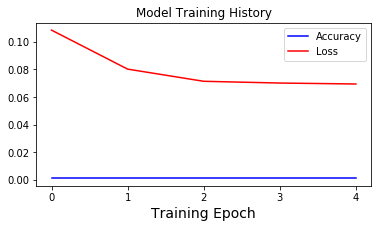

[io] Figure saved as results/model3/model3_keras_history  09-18-2019 20-25-34.png


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------
Evaluating Train Generator:
1806/1806 [==============================] - 8s 5ms/step
    - Accuracy:0.0011
    - Loss:0.0424
Evaluating Test Generator:
126/126 [==============================] - 1s 5ms/step
    - Accuracy:0.0000
    - Loss:0.0496


Metric,Value
R Squared,0.394
Root Mean Squared Error,0.059
Thiel's U,2.547


In [77]:
## FIT MODEL
dashes = '---'*20
print(f"{dashes}\n\tFITTING MODEL:\n{dashes}")

## set params
epochs=5

# override keras warnings
ji.quiet_mode(True,True,True)

# Instantiating clock timer
clock = bs.Clock()
clock.tic('')

# Fit the model
history = model3.fit_generator(train_generator,
                               epochs=epochs,
                               verbose=2, 
                               use_multiprocessing=True,
                               workers=3)
clock.toc('')

model_key = "model_3"
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

# eval_results = ji.evaluate_model_plot_history(model1, train_generator, test_generator)
ji.evaluate_regression_model(model3,history,
                             train_generator=train_generator,
                             test_generator=test_generator,
                            true_test_series=df_test['price'],
                            true_train_series =df_train['price'],
                             save_history=True,history_filename=hist_fname,
                             save_summary=True, summary_filename=summary_fname)

In [78]:
### PREFER NEW WAY - GET DF_MODEL FIRST THEN GET EVALUATE_REGRESSION INFORMATION?
## Get true vs pred data as a dataframe and iplot
df_model3 = ji.get_model_preds_df(model3, 
                                  test_generator = test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  include_train_data=True,
                                  inverse_tf = True, 
                                  scaler = scaler_library['price'],
                                  preds_from_gen = True, 
                                  iplot = False,
                                  verbose=1)

ji.plotly_true_vs_preds_subplots(df_model3,title='Model 3: True Vs Predicted S&P 500 Price')
    
# Get evaluation metrics
df_results3, dfs_results3, df_shifted3 =\
ji.compare_eval_metrics_for_shifts(df_model3['true_test_price'],
                                   df_model3['pred_from_gen'],
                                   shift_list=np.arange(-4,4,1),
                                   true_train_series_to_add=df_model3['true_train_price'],
                                   display_results=True,
                                   display_U_info=True,
                                   return_results=True,
                                   return_styled_df=True,
                                   return_shifted_df=True)


save_model=True
ji.save_model_dfs(file_dict, 'model_3',df_model3,dfs_results3,df_shifted3)

[i] Using all columns...


,true_train_price,true_test_price,pred_from_gen
2018-07-30 09:30:00,111.25,nan,nan
2018-07-30 10:30:00,111.82,nan,nan
2018-07-30 11:30:00,111.74,nan,nan


,true_train_price,true_test_price,pred_from_gen
2019-08-23 12:30:00,nan,113.11,113.908
2019-08-23 13:30:00,nan,112.72,113.113
2019-08-23 14:30:00,nan,112.91,113.666


<IPython.core.display.Latex object>

|Thiel's U Value | Interpretation |
    | --- | --- |
    | <1 | Forecasting is better than guessing| 
    | 1 | Forecasting is about as good as guessing| 
    |>1 | Forecasting is worse than guessing| 


Pred Shifted,R^2,RMSE,U
-4,0.4209,1.4915,2.5741
-3,0.4146,1.4967,2.5376
-2,0.4139,1.4967,2.55
-1,0.4229,1.4867,2.5388
0,0.3942,1.5232,2.6182
1,0.3485,1.5504,2.6544
2,0.3036,1.564,2.6801
3,0.242,1.5936,2.7215


[i] df_model saved as results/model3/model3_df_model_true_vs_preds.csv
Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               

[i] df_results saved as results/model3/model3_df_results.xlsx
[i] df_shifted saved as results/model3/model3_df_shifted.csv


In [79]:
filename_prefix = file_dict['model_3']['base_filename']
if save_model ==True:
    model_3_output_files = bs.save_model_weights_params(model3,
                                 filename_prefix=filename_prefix,
                                 auto_increment_name=True,
                                 auto_filename_suffix=True, 
                                 suffix_time_format='%m-%d-%y_%I%M%p',
                                 save_model_layer_config_xlsx=True)

Model saved as models/stocks/model3___09-18-19_0825pm.json
Weights saved as models/stocks/model3___09-18-19_0825pm_weights.h5
Model configuration table saved as models/stocks/model3___09-18-19_0825pm_model_layers.xlsx


### Model 3 Summary

- Using Stock Price plus technical indicators, and with a prediction time-shift of -1, we achieved:
    - $R^2$ value of 
    - RMSE value of 
    - Thiel's $U$ value of 
- This means our second model can explain \_\_% of the variance in the data ($R^2$) and that our model performed ~~significantly better~~ than guessing (Thiel's U value ~~<1.0~~)

- It is surprisng that the model's performance is so poor by adding the technical indicators.
    - Further investigation is required to understand why the $R^2$ value is negative. 

## Model X: XGB Regression + Feature Importance


In [89]:
## SPECIFY # OF TRAINING TEST DAYS 
reload(ji)
num_test_days=20
num_train_days=2*52*5
### SPECIFY Number of days included in each X_sequence (each prediction)
days_for_x_window=1

cols_to_exclude = ['pred_classes','has_tweets']
# Calculate number of rows to bin for x_windows
periods_per_day = ji.get_day_window_size_from_freq(df_to_model.drop(cols_to_exclude,axis=1), ji.custom_BH_freq() )


## Get the number of rows for x_window 
x_window = periods_per_day * days_for_x_window#data_params['days_for_x_window'] 
print(f'X_window size = {x_window} -- ({days_for_x_window} day(s) * {periods_per_day} rows/day)\n')

## Train-test-split by the # of days
df_train, df_test = ji.train_test_split_by_last_days(df_to_model.drop(cols_to_exclude,axis=1),
                                                     periods_per_day =periods_per_day, 
                                                     num_test_days   = num_test_days,
                                                     num_train_days  = num_train_days,
                                                     verbose=1, iplot=True)

###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
display(df_train.head(2).style.set_caption('df_train - pre-scaling'))

scaler_library, df_train = ji.make_scaler_library(df_train, transform=True, verbose=1)

df_test = ji.transform_cols_from_library(df_test, col_list=None,
                                         scaler_library=scaler_library,
                                         inverse=False)
display(df_train.head(2).style.set_caption('df_train - post-scaling'))


X_window size = 7 -- (1 day(s) * 7 rows/day)

training dates:	2017-07-31 09:30:00 	 2019-07-26 15:30:00 = 3640 rows
test dates:	2019-07-26 15:30:00 	 2019-08-23 14:30:00 = 140 rows


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,num_tweets,case_ratio,compound_score,pos,neu,neg,sentiment_class,pred_classes_int,total_favorite_count,total_retweet_count
date_time,,,,,,,,,,,,,,,,,,,,,
2017-07-31 09:30:00,101.3,101.131,100.659,100.652,100.943,0.291908,0.48363,101.626,99.6912,101.252,94.3,0,0,0,0,0,0,1,1,0,0
2017-07-31 10:30:00,101.3,101.135,100.667,100.659,100.952,0.29321,0.486058,101.639,99.695,101.284,94.3,0,0,0,0,0,0,1,1,0,0


[i] Using all columns...


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,num_tweets,case_ratio,compound_score,pos,neu,neg,sentiment_class,pred_classes_int,total_favorite_count,total_retweet_count
date_time,,,,,,,,,,,,,,,,,,,,,
2017-07-31 09:30:00,0.27944,0.187023,0.0363612,0.0276083,0.0789351,0.713294,0.029596,0.0283526,0.267945,0.270473,0.27944,0,0,0.5,0,0,0,0.5,0.5,0,0
2017-07-31 10:30:00,0.27944,0.187203,0.0368308,0.0280141,0.0793719,0.713552,0.03012,0.029061,0.268103,0.271735,0.27944,0,0,0.5,0,0,0,0.5,0.5,0,0


In [90]:
## Shift price values such that the y-value being predicted is the following hour's Closing Price
df_train['price_shifted'] = df_train['price'].shift(-1)
df_test['price_shifted'] = df_test['price'].shift(-1)

display(df_train[['price','price_shifted','momentum','ema','num_tweets',]].head(10))

# Drop the couple of null values created by the shift
df_train.dropna(subset=['price_shifted'], inplace=True)
df_test.dropna(subset=['price_shifted'], inplace=True)

## Drop columns and make train-test-X and y
target_col = 'price_shifted'
drop_cols = ['price_shifted','price']

X_train = df_train.drop(drop_cols,axis=1)
y_train = df_train[target_col]
X_test = df_test.drop(drop_cols,axis=1)
y_test = df_test[target_col]

,price,price_shifted,momentum,ema,num_tweets
date_time,,,,,
2017-07-31 09:30:00,0.279440,0.279440,0.279440,0.270473,0.00000
2017-07-31 10:30:00,0.279440,0.285659,0.279440,0.271735,0.00000
2017-07-31 11:30:00,0.285659,0.285659,0.285659,0.276358,0.00000
2017-07-31 12:30:00,0.285659,0.289545,0.285659,0.277899,0.04918
2017-07-31 13:30:00,0.289545,0.289545,0.289545,0.281040,0.00000
2017-07-31 14:30:00,0.289545,0.290711,0.289545,0.282087,0.00000
2017-07-31 15:30:00,0.290711,0.294209,0.290711,0.283224,0.00000
2017-08-01 09:30:00,0.294209,0.289157,0.294209,0.285967,0.00000
2017-08-01 10:30:00,0.289157,0.287602,0.289157,0.283467,0.00000


In [ ]:
import xgboost as xgb
from xgboost import plot_importance, plot_tree
from sklearn.metrics import mean_squared_error, mean_absolute_error
clock = bs.Clock()
clock.tic('')
reg = xgb.XGBRegressor(n_estimators=1000,silent=False,max_depth=4)

reg.fit(X_train, y_train,
        eval_set=[(X_train, y_train), (X_test, y_test)],
        early_stopping_rounds=50,
       verbose=False)


## Get Predictions
pred_price = reg.predict(X_test)
pred_price_series = pd.Series(pred_price,index=df_test.index,name='pred_test_price')#.plot()
df_xgb = pd.concat([df_train['price'].rename('true_train_price'), pred_price_series,df_test['price'].rename('true_test_price')],axis=1)


df_results = ji.evaluate_regression(df_test['price'], pred_price_series,show_results=True);

clock.toc('')
fig = ji.plotly_true_vs_preds_subplots(df_xgb,true_train_col='true_train_price',
                                true_test_col='true_test_price',
                                pred_test_columns='pred_test_price',
                                      title='Model X: True Vs Predicted S&P 500 Price')


## PLOT FEATURE IMPORTANCE
feature_importance={}
for import_type in ['weight','gain','cover']:
    reg.importance_type = import_type
    cur_importances = reg.feature_importances_
    feature_importance[import_type] = pd.Series(data = cur_importances,
                                               index=df_train.drop(drop_cols,axis=1).columns,
                                               name=import_type)

df_importance = pd.DataFrame(feature_importance)

In [112]:
    
importance_fig = df_importance.sort_values(by='weight', ascending=True).iplot(kind='barh',theme='solar',
                                                                    title='Feature Importance',
                                                                    xTitle='Relative Importance<br>(sum=1.0)',
                                                                    asFigure=True,dimensions=(1000, 600))

iplot(importance_fig)

In [95]:
ihelp(df_importance.iplot)

------------------------------------------------------------------------------------
------ HELP ------------------------------------------------------------------------

Help on method _iplot in module cufflinks.plotlytools:

_iplot(kind='scatter', data=None, layout=None, filename='', sharing=None, title='', xTitle='', yTitle='', zTitle='', theme=None, colors=None, colorscale=None, fill=False, width=None, dash='solid', mode='', interpolation='linear', symbol='circle', size=12, barmode='', sortbars=False, bargap=None, bargroupgap=None, bins=None, histnorm='', histfunc='count', orientation='v', boxpoints=False, annotations=None, keys=False, bestfit=False, bestfit_colors=None, mean=False, mean_colors=None, categories='', x='', y='', z='', text='', gridcolor=None, zerolinecolor=None, margin=None, labels=None, values=None, secondary_y='', secondary_y_title='', subplots=False, shape=None, error_x=None, error_y=None, error_type='data', locations=None, lon=None, lat=None, asFrame=False, asDat

```python
def _iplot(self,kind='scatter',data=None,layout=None,filename='',sharing=None,title='',xTitle='',yTitle='',zTitle='',theme=None,colors=None,colorscale=None,fill=False,width=None,
			dash='solid',mode='',interpolation='linear',symbol='circle',size=12,barmode='',sortbars=False,bargap=None,bargroupgap=None,bins=None,histnorm='',
			histfunc='count',orientation='v',boxpoints=False,annotations=None,keys=False,bestfit=False,
			bestfit_colors=None,mean=False,mean_colors=None,categories='',x='',y='',z='',text='',gridcolor=None,
			zerolinecolor=None,margin=None,labels=None,values=None,secondary_y='',secondary_y_title='',subplots=False,shape=None,error_x=None,
			error_y=None,error_type='data',locations=None,lon=None,lat=None,asFrame=False,asDates=False,asFigure=False,
			asImage=False,dimensions=None,asPlot=False,asUrl=False,online=None,**kwargs):
	"""
	Returns a plotly chart either as inline chart, image of Figure object

	Parameters:
	-----------
		kind : string
			Kind of chart
				scatter
				bar
				box
				spread
				ratio
				heatmap
				surface
				histogram
				bubble
				bubble3d
				scatter3d	
				scattergeo
				ohlc
				candle
				pie
				choroplet	
		data : Data
			Plotly Data Object.
			If not entered then the Data object will be automatically
			generated from the DataFrame.
		layout : Layout
			Plotly layout Object
			If not entered then the Layout objet will be automatically
			generated from the DataFrame.
		filename : string
			Filename to be saved as in plotly account
		sharing : string
			Sets the sharing level permission
				public - anyone can see this chart
				private - only you can see this chart
				secret - only people with the link can see the chart
		title : string
			Chart Title				
		xTitle : string
			X Axis Title
		yTitle : string
			Y Axis Title
				zTitle : string
		zTitle : string
			Z Axis Title
			Applicable only for 3d charts
		theme : string
			Layout Theme
				solar
				pearl
				white		
			see cufflinks.getThemes() for all 
			available themes
		colors : dict, list or string
			{key:color} to specify the color for each column
			[colors] to use the colors in the defined order
		colorscale : string
			Color scale name
			If the color name is preceded by a minus (-) 
			then the scale is inversed
			Only valid if 'colors' is null
			See cufflinks.colors.scales() for available scales
		fill : bool
			Filled Traces		
		width : dict, list or int
				int : applies to all traces
				list : applies to each trace in the order 
						specified
				dict: {column:value} for each column in 
						the dataframe
			Line width	
		dash : dict, list or string
				string : applies to all traces
				list : applies to each trace in the order 
						specified
				dict: {column:value} for each column in 
						the dataframe
			Drawing style of lines
				solid
				dash
				dashdot
				dot
		mode : dict, list or string
				string : applies to all traces
				list : applies to each trace in the order 
						specified
				dict: {column:value} for each column in 
						the dataframe
			Plotting mode for scatter trace
				lines
				markers
				lines+markers
				lines+text
				markers+text
				lines+markers+text
		interpolation : dict, list, or string
				string : applies to all traces
				list : applies to each trace in the order 
						specified
				dict: {column:value} for each column in 
						the dataframe
			Positioning of the connecting lines
				linear
				spline
				vhv
				hvh
				vh
				hv		
		symbol : dict, list or string
				string : applies to all traces
				list : applies to each trace in the order 
						specified
				dict: {column:value} for each column in 
						the dataframe
			The symbol that is drawn on the plot for each marker
			Valid only when mode includes markers
				circle
				circle-dot
				diamond
				square
				and many more...(see plotly.validators.scatter.marker.SymbolValidator.values)
		size : string or int 
			Size of marker 
			Valid only if marker in mode
		barmode : string
			Mode when displaying bars
				group
				stack
				overlay
			* Only valid when kind='bar'
		sortbars : bool
			Sort bars in descending order
			* Only valid when kind='bar'
		bargap : float
			Sets the gap between bars
				[0,1)
			* Only valid when kind is 'histogram' or 'bar'
		bargroupgap : float
			Set the gap between groups
				[0,1)
			* Only valid when kind is 'histogram' or 'bar'		
		bins : int or tuple 
			if int:
				Specifies the number of bins 
			if tuple:
				(start, end, size)
				start : starting value
				end: end value
				size: bin size
			* Only valid when kind='histogram'

		histnorm : string
				'' (frequency)
				percent
				probability
				density
				probability density
			Sets the type of normalization for an histogram trace. By default
			the height of each bar displays the frequency of occurrence, i.e., 
			the number of times this value was found in the
			corresponding bin. If set to 'percent', the height of each bar
			displays the percentage of total occurrences found within the
			corresponding bin. If set to 'probability', the height of each bar
			displays the probability that an event will fall into the
			corresponding bin. If set to 'density', the height of each bar is
			equal to the number of occurrences in a bin divided by the size of
			the bin interval such that summing the area of all bins will yield
			the total number of occurrences. If set to 'probability density',
			the height of each bar is equal to the number of probability that an
			event will fall into the corresponding bin divided by the size of
			the bin interval such that summing the area of all bins will yield
			1.
			* Only valid when kind='histogram'
		histfunc : string
				count
				sum
				avg
				min
				max
		   Sets the binning function used for an histogram trace. 
			* Only valid when kind='histogram'           
		orientation : string
				h 
				v
			Sets the orientation of the bars. If set to 'v', the length of each
 |          bar will run vertically. If set to 'h', the length of each bar will
 |          run horizontally
			* Only valid when kind is 'histogram','bar' or 'box'
		boxpoints : string
			Displays data points in a box plot
				outliers
				all
				suspectedoutliers
				False
		annotations : dictionary
			Dictionary of annotations
			{x_point : text}
		keys : list of columns
			List of columns to chart.
			Also can be used for custom sorting.
		bestfit : boolean or list
			If True then a best fit line will be generated for
			all columns.
			If list then a best fit line will be generated for
			each key on the list.
		bestfit_colors : list or dict
			{key:color} to specify the color for each column
			[colors] to use the colors in the defined order	
		categories : string
			Name of the column that contains the categories
		x : string
			Name of the column that contains the x axis values		
		y : string
			Name of the column that contains the y axis values
		z : string
			Name of the column that contains the z axis values					
		text : string
			Name of the column that contains the text values	
		gridcolor : string
			Grid color	
		zerolinecolor : string
			Zero line color
		margin : dict or tuple
			Dictionary (l,r,b,t) or
			Tuple containing the left,
			right, bottom and top margins
		labels : string
			Name of the column that contains the labels.
			* Only valid when kind='pie' 
		values : string
			Name of the column that contains the values.
			* Only valid when kind='pie'
		secondary_y : string or list(string)
			Name(s) of the column to be charted on the 
			right hand side axis
		secondary_y_title : string
			Title of the secondary axis
		subplots : bool
			If true then each trace is placed in 
			subplot layout
		shape : (rows,cols)
			Tuple indicating the size of rows and columns
			If omitted then the layout is automatically set
			* Only valid when subplots=True
		error_x : int or float or [int or float]
			error values for the x axis
		error_y : int or float or [int or float]
			error values for the y axis
		error_type : string
			type of error bars
				'data' 
				'constant'
				'percent'
				'sqrt'
				'continuous'
				'continuous_percent'
		asFrame : bool
			If true then the data component of Figure will
			be of Pandas form (Series) otherwise they will 
			be index values
		asDates : bool
			If true it truncates times from a DatetimeIndex
		asFigure : bool
			If True returns plotly Figure
		asImage : bool
			If True it returns an Image (png)
			In ONLINE mode:
				Image file is saved in the working directory				
					Accepts:
						filename
						dimensions
						scale
						display_image
			In OFFLINE mode:
				Image file is downloaded (downloads folder) and a 
				regular plotly chart is displayed in Jupyter
					Accepts:
						filename
						dimensions
		dimensions : tuple(int,int)
			Dimensions for image / chart
				(width,height)		
		asPlot : bool
			If True the chart opens in browser
		asUrl : bool
			If True the chart url/path is returned. No chart is displayed. 
				If Online : the URL is returned
				If Offline : the local path is returned
		online : bool
			If True then the chart/image is rendered on the server 
			even when running in offline mode. 

		Other Kwargs
		============
		Line, Scatter
			connectgaps : bool
				If True, empty values are connected 
		Pie charts
			sort : bool
				If True it sorts the labels by value
			pull : float [0-1]
				Pulls the slices from the centre 
			hole : float [0-1]
				Sets the size of the inner hole
			linecolor : string
				Sets the color for the contour line of the slices
			linewidth : string
				Sets the width for the contour line of the slices	
			textcolor : string
				Sets the color for the text in the slices
			textposition : string 
				Sets the position of the legends for each slice
					outside
					inner
			textinfo : string 
				Sets the information to be displayed on 
				the legends 
					label
					percent
					value
					* or ony combination of the above using 
					  '+' between each item
					  ie 'label+percent'

		Histogram
			linecolor : string
				specifies the line color of the histogram

		Heatmap and Surface
			center_scale : float
				Centers the colorscale at a specific value
				Automatically sets the (zmin,zmax) values
			zmin : float
				Defines the minimum range for the z values. 
				This affects the range for the colorscale
			zmax : float
				Defines the maximum range for the z values. 
				This affects the range for the colorscale

		Error Bars
			error_trace : string
				Name of the column for which error should be 
				plotted. If omitted then errors apply to all 
				traces.
			error_values_minus : int or float or [int or float]
				Values corresponding to the span of the error bars 
				below the trace coordinates
			error_color : string
				Color for error bars
			error_thickness : float 
				Sets the line thickness of the error bars
			error_width :  float
				Sets the width (in pixels) of the cross-bar at both 
				ends of the error bars
			error_opacity : float [0,1]
				Opacity for the error bars

		Subplots
			horizontal_spacing : float [0,1]
				Space between subplot columns.
			vertical_spacing : float [0,1]
				Space between subplot rows.
			subplot_titles : bool
				If True, chart titles are plotted
				at the top of each subplot
			shared_xaxes : bool
				Assign shared x axes.
				If True, subplots in the same grid column have one common
				shared x-axis at the bottom of the grid.
			shared_yaxes : bool
				Assign shared y axes.
				If True, subplots in the same grid row have one common
				shared y-axis on the left-hand side of the grid.

		Shapes
			hline : float, list or dict
				Draws a horizontal line at the 
				indicated y position(s)
				Extra parameters can be passed in
				the form of a dictionary (see shapes)
			vline : float, list or dict
				Draws a vertical line at the 
				indicated x position(s)
				Extra parameters can be passed in
				the form of a dictionary (see shapes)
			hpsan : (y0,y1)
				Draws a horizontal rectangle at the 
				indicated (y0,y1) positions.
				Extra parameters can be passed in
				the form of a dictionary (see shapes)
			vspan : (x0,x1)
				Draws a vertical rectangle at the 
				indicated (x0,x1) positions.
				Extra parameters can be passed in
				the form of a dictionary (see shapes)
			shapes : dict or list(dict)
				List of dictionaries with the 
				specifications of a given shape.
				See help(cufflinks.tools.get_shape)
				for more information
		
		Axis Ranges
			xrange : [lower_bound,upper_bound]
				Sets the range for the x axis
			yrange : [lower_bound,upper_bound]
				Sets the range for the y axis
			zrange : [lower_bound,upper_bound]
				Sets the range for the z axis
				
		Explicit Layout Updates
			layout_update : dict
				The layout will be modified with all 
				the explicit values stated in the 
				dictionary. 
				It will not apply if layout is passed
				as parameter.


		Range Selector
			rangeselector : dict
				Defines a rangeselector object
				see help(cf.tools.get_range_selector) for more information
				Example:
					{'steps':['1y','2 months','5 weeks','ytd','2mtd'],
					 'axis':'xaxis', 'bgcolor' : ('blue',.3),
					 'x': 0.2 , 'y' : 0.9}

		Range Slider
			rangeslider : bool or dict
				Defines if a rangeslider is displayed
				If bool: 
					True : Makes it visible
				if dict:
					Rangeslider object
				Example:
					{'bgcolor':('blue',.3),'autorange':True}

		Annotations
			fontcolor : str
				Text color for annotations
			fontsize : int
				Text size for annotations
			textangle : int
				Text angle 
			See https://plot.ly/python/reference/#layout-annotations 
			for a complete list of valid parameters.

		Exports
			display_image : bool
				If True then the image if displayed after being saved
				** only valid if asImage=True
			scale : integer
				Increase the resolution of the image by `scale` amount
				Only valid when asImage=True		
	"""

	# Valid Kwargs
	valid_kwargs = ['color','opacity','column','columns','labels','text','world_readable','colorbar']
	BUBBLE_KWARGS = ['abs_size']
	TRACE_KWARGS = ['hoverinfo','connectgaps']
	HEATMAP_SURFACE_KWARGS = ['center_scale','zmin','zmax']
	PIE_KWARGS=['sort','pull','hole','textposition','textinfo','linecolor','linewidth','textcolor']
	OHLC_KWARGS=['up_color','down_color','open','high','low','close','volume','name','decreasing','increasing']
	SUBPLOT_KWARGS=['horizontal_spacing', 'vertical_spacing',
					'specs', 'insets','start_cell','shared_xaxes','shared_yaxes','subplot_titles','shared_xaxis','shared_yaxis']
	GEO_KWARGS=['locationmode','locationsrc','geo','lon','lat']
	ERROR_KWARGS=['error_trace','error_values_minus','error_color','error_thickness',
					'error_width','error_opacity']
	EXPORT_KWARGS=['display_image','scale']
	FF_DISTPLOT=["group_labels", "bin_size", "curve_type", "rug_text", "show_hist", "show_curve", "show_rug"]
	FF_VIOLIN=["data_header","group_header","show_rug","sort"]
	kwargs_list = [tools.__LAYOUT_KWARGS,BUBBLE_KWARGS,TRACE_KWARGS,
				   OHLC_KWARGS,PIE_KWARGS,HEATMAP_SURFACE_KWARGS,SUBPLOT_KWARGS,GEO_KWARGS,ERROR_KWARGS,EXPORT_KWARGS,
				   FF_DISTPLOT,FF_VIOLIN]
	[valid_kwargs.extend(_) for _ in kwargs_list]

	dict_modifiers_keys = ['line']
	dict_modifiers={}

	for k in dict_modifiers_keys:
		dict_modifiers[k]=kwargs_from_keyword(kwargs,{},k,True)
	

	for key in list(kwargs.keys()):
		if key not in valid_kwargs:
			raise Exception("Invalid keyword : '{0}'".format(key))

	# Setting default values
	if not colors:
		colors=kwargs['color'] if 'color' in kwargs else colors
	if isinstance(colors,str):
		colors=[colors]
	opacity=kwargs['opacity'] if 'opacity' in kwargs else 0.8
	if not dimensions:
		dimensions=auth.get_config_file()['dimensions']

	# Get values from config theme
	if theme is None:
		theme = auth.get_config_file()['theme']
	theme_config=tools.getTheme(theme)
	if colorscale is None:
		config_colorscale=auth.get_config_file()['colorscale']
		if config_colorscale in ('dflt',None):
			colorscale=theme_config['colorscale'] if 'colorscale' in theme_config else 'original'
		else:
			colorscale=config_colorscale
	if width is None:
		if kind != 'pie':
			width=theme_config['linewidth'] if 'linewidth' in theme_config else 2
	if margin is None:
		margin=auth.get_config_file().get('margin',None)


	# In case column was used instead of keys
	if 'column' in kwargs:
		keys=[kwargs['column']] if isinstance(kwargs['column'],str) else kwargs['column']
	if 'columns' in kwargs:
		keys=[kwargs['columns']] if isinstance(kwargs['columns'],str) else kwargs['columns']
	kind='line' if kind=='lines' else kind

	# Figure generators
	def get_marker(marker={}):
		if 'line' in dict_modifiers:
			if 'color' not in dict_modifiers['line']:
				if 'linecolor' in kwargs:
					linecolor=kwargs.get('linecolor')
				else:
					if 'linecolor' in tools.getTheme(theme=theme):
						linecolor=normalize(tools.getTheme(theme=theme)['linecolor'])
					else: 
						linecolor=tools.getLayout(theme=theme)['xaxis']['titlefont']['color']
				dict_modifiers['line']['color']=linecolor			
			dict_modifiers['line']=tools.updateColors(dict_modifiers['line'])
			marker['line']=deep_update(marker['line'],dict_modifiers['line'])
		return marker

	# We assume we are good citizens
	validate=True
	

	if not layout:
		l_kwargs=dict([(k,kwargs[k]) for k in tools.__LAYOUT_KWARGS if k in kwargs])
		if annotations:
			ann_kwargs=check_kwargs(kwargs,tools.__ANN_KWARGS,clean_origin=True)
			annotations=tools.get_annotations(self.copy(),annotations,kind=kind,theme=theme,**ann_kwargs)


		layout=tools.getLayout(kind=kind,theme=theme,xTitle=xTitle,yTitle=yTitle,zTitle=zTitle,title=title,barmode=barmode,
								bargap=bargap,bargroupgap=bargroupgap,annotations=annotations,gridcolor=gridcolor,
							   dimensions=dimensions,
								zerolinecolor=zerolinecolor,margin=margin,is3d='3d' in kind,**l_kwargs)
	elif isinstance(layout, Layout):
		layout = layout.to_plotly_json()

	if not data:
		if categories and kind not in ('violin'):
			data=[]
			if 'bar' in kind:
				df=self.copy()
				df=df.set_index(categories)
				fig=df.figure(kind=kind,colors=colors,colorscale=colorscale,fill=fill,width=width,sortbars=sortbars,opacity=opacity,
						asDates=asDates,mode=mode,symbol=symbol,size=size,text=text,barmode=barmode,orientation=orientation)
				data=fig['data']			
			else:
				_keys=pd.unique(self[categories])
				colors=get_colors(colors,colorscale,_keys)	
				mode='markers' if not mode else mode
				for _ in _keys:
					__=self[self[categories]==_].copy()
					if text:
						_text=__[text] if asFrame else __[text].values
					_x=__[x] if asFrame else __[x].values
					_y=__[y] if asFrame else __[y].values
					if z:
						_z=__[z] if asFrame else __[z].values
					if 'bubble' in kind:
						rg=__[size].values
						rgo=self[size].values
						if not kwargs.get('abs_size',False):
							if len(rgo)>1:
								_size=[int(100*(float(i)-rgo.min( ))/(rgo.max()-rgo.min()))+12 for i in rg]		
							else:
								_size=[12] if len(rgo) else []
						else:
							_size=rgo
					else:
						_size=size
					_data=Scatter3d(x=_x,y=_y,mode=mode,name=_,
								marker=dict(color=colors[_],symbol=symbol,size=_size,opacity=opacity,
												line=dict(width=width)),textfont=tools.getLayout(theme=theme)['xaxis']['titlefont'])
					if '3d' in kind:
						_data=Scatter3d(x=_x,y=_y,z=_z,mode=mode,name=_,
								marker=dict(color=colors[_],symbol=symbol,size=_size,opacity=opacity,
												line=dict(width=width)),textfont=tools.getLayout(theme=theme)['xaxis']['titlefont'])
					else:
						#see error 168
						if type(_x)==pd.np.ndarray:
							if '[ns]' in _x.dtype.str:
								_x=_x.astype(str)
						if type(_y)==pd.np.ndarray:
							if '[ns]' in _y.dtype.str:
								_y=_y.astype(str)
						
						_data=Scatter(x=_x,y=_y,mode=mode,name=_,
								marker=dict(color=colors[_],symbol=symbol,size=_size,opacity=opacity,
												line=dict(width=width)),textfont=tools.getLayout(theme=theme)['xaxis']['titlefont'])
					if text:
						_data.update(text=_text)
					data.append(_data)
		else:
			if kind in ('scatter','spread','ratio','bar','barh','area','line'):
				df=self.copy()
				if type(df)==pd.core.series.Series:
					df=pd.DataFrame({df.name:df})
				if x:
					df=df.set_index(x)
				if y and secondary_y:
					_y = [y] if not isinstance(y, list) else y
					_secondary_y = [secondary_y] if not isinstance(secondary_y, list) else secondary_y
					df=df[_y + _secondary_y]
				elif y:
					df=df[y]
				if kind=='area':
					df=df.transpose().fillna(0).cumsum().transpose()
				mode='lines' if not mode else mode
				if text:
					if not isinstance(text,list):
						text=self[text].values
				data=df.to_iplot(colors=colors,colorscale=colorscale,kind=kind,interpolation=interpolation,fill=fill,width=width,dash=dash,sortbars=sortbars,keys=keys,
						bestfit=bestfit,bestfit_colors=bestfit_colors,mean=mean,mean_colors=mean_colors,asDates=asDates,mode=mode,symbol=symbol,size=size,
						text=text,**kwargs)		
				trace_kw=check_kwargs(kwargs,TRACE_KWARGS)
				for trace in data:
					trace.update(**trace_kw)		
						
				if kind in ('spread','ratio'):
						if kind=='spread':
							trace=self.apply(lambda x:x[0]-x[1],axis=1)
							positive=trace.apply(lambda x:x if x>=0 else pd.np.nan)
							negative=trace.apply(lambda x:x if x<0 else pd.np.nan)
							trace=pd.DataFrame({'positive':positive,'negative':negative})
							trace=trace.to_iplot(colors={'positive':'green','negative':'red'},width=0.5)
						else:
							trace=self.apply(lambda x:x[0]*1.0/x[1],axis=1).to_iplot(colors=['green'],width=1)
						for t in trace:
							t.update({'xaxis':'x2','yaxis':'y2','fill':'tozeroy',
											'name':kind.capitalize(),'connectgaps':False,'showlegend':False})
						data.append(trace[0])
						if kind=='spread':
							data.append(trace[1])
						layout['yaxis'].update({'domain':[.3,1]})
						layout['yaxis2']=copy.deepcopy(layout['yaxis'])
						layout['xaxis2']=copy.deepcopy(layout['xaxis'])
						layout['yaxis2'].update(domain=[0,.25],title=kind.capitalize())
						layout['xaxis2'].update(anchor='y2',showticklabels=False)
						layout['hovermode']='x'
				if 'bar' in kind:
					if 'stack' in barmode:
						layout['legend'].update(traceorder='normal')
					orientation = 'h' if kind=='barh' else orientation
					for trace in data:
						trace.update(orientation=orientation)
						if orientation=='h':
							trace['x'],trace['y']=trace['y'],trace['x']	
						
			elif kind=='bubble':
				mode='markers' if 'markers' not in mode else mode 
				x=self[x].values.tolist()
				y=self[y].values.tolist()
				z=size if size else z
				rg=self[z].values
				if not kwargs.get('abs_size',False):
					if len(rg) > 1:
						z=[int(100*(float(_)-rg.min())/(rg.max()-rg.min()))+12 for _ in rg]
					else:
						z=[12] if len(rg) else []
				else:
					z=rg
				text=kwargs['labels'] if 'labels' in kwargs else text
				labels=self[text].values.tolist() if text else ''
				clrs=colors if colors else get_scales(colorscale)
				clrs=[clrs] if not isinstance(clrs,list) else clrs
				clrs=[clrs[0]]*len(x) if len(clrs)==1 else clrs
				marker=dict(color=clrs,size=z,symbol=symbol,
								line=dict(width=width))
				trace=Scatter(x=x,y=y,marker=marker,mode='markers',text=labels)
				data=[trace]
			elif kind in ('box','histogram','hist'):
				if isinstance(self,pd.core.series.Series):
					df=pd.DataFrame({self.name:self})
				else:
					df=self.copy()
				data=[]
				clrs=get_colors(colors,colorscale,df.columns)
				if 'hist' in kind:
					barmode = 'overlay' if barmode=='' else	 barmode 
					layout.update(barmode=barmode) 
				columns=keys if keys else df.columns
				for _ in columns:
					if kind=='box':
						__=Box(y=df[_].values.tolist(),marker=dict(color=clrs[_]),name=_,
								line=dict(width=width),boxpoints=boxpoints)
						# 114 - Horizontal Box
						__['orientation']=orientation
						if orientation=='h':
							__['x'],__['y']=__['y'],__['x']	
						
					else:
						__=dict(x=df[_].values.tolist(),name=_,
								marker=dict(color=clrs[_], line=dict(width=width)),
								orientation=orientation,
								opacity=kwargs['opacity'] if 'opacity' in kwargs else .8, histfunc=histfunc,
								histnorm=histnorm)

						__['marker']=get_marker(__['marker'])

						if orientation=='h':
							__['y']=__['x']
							del __['x']
						__ = Histogram(__)
						if bins:
							if type(bins) in (tuple,list):
								try:
									_bins={'start':bins[0],'end':bins[1],'size':bins[2]}
									if orientation=='h':
										__.update(ybins=_bins,autobiny=False)	
									else:
										__.update(xbins=_bins,autobinx=False)	
								except:
									print("Invalid format for bins generation")
							else:
								if orientation=='h':
									__.update(nbinsy=bins)	
								else:
									__.update(nbinsx=bins)
					data.append(__)

			elif kind in ('heatmap','surface'):
				if x:
					x=self[x].values.tolist()
				else:
					if self.index.__class__.__name__ in ('PeriodIndex','DatetimeIndex'):
						x=self.index.format()
					else:
						x=self.index.values.tolist()
				y=self[y].values.tolist() if y else self.columns.values.tolist()
				z=self[z].values.tolist() if z else self.values.transpose()
				scale=get_scales('rdbu') if not colorscale else get_scales(colorscale)
				colorscale=[[float(_)/(len(scale)-1),scale[_]] for _ in range(len(scale))]
				center_scale = kwargs.get('center_scale',None)
				
				if is_list(z):				
					zmin=min(z)
					zmax=max(z)
				else:
					zmin=z.min()
					zmax=z.max()
					
				if center_scale is not None:
					if center_scale<=zmin+(zmax-zmin)/2:
						zmin=center_scale*2-zmax
					else:
						zmax=center_scale*2-zmin
				zmin=kwargs.get('zmin',zmin)
				zmax=kwargs.get('zmax',zmax)
				if kind=='heatmap':
					data=[Heatmap(z=z,x=x,y=y,zmin=zmin,zmax=zmax,colorscale=colorscale)]
				else:
					data=[Surface(z=z,x=x,y=y,colorscale=colorscale)]

			elif kind in ('scatter3d','bubble3d'):
				data=[]
				keys=self[text].values if text else list(range(len(self)))
				colors=get_colors(colors,colorscale,keys,asList=True)
				mode='markers' if 'markers' not in mode else mode 
				df=self.copy()
				df['index']=keys
				if kind=='bubble3d':
					rg=self[size].values
					if not kwargs.get('abs_size',False):
						size=[int(100*(float(_)-rg.min())/(rg.max()-rg.min()))+12 for _ in rg]
					else:
						size=rg
				else:
					size=[size for _ in range(len(keys))]	

				_data=Scatter3d(x=df[x].values.tolist(),y=df[y].values.tolist(),z=df[z].values.tolist(),mode=mode,text=keys,
									marker=dict(color=colors,symbol=symbol,size=size,opacity=.8))
				if text:
					_data.update(text=keys)
				data.append(_data)

			elif kind=='pie':
				if not labels:
					raise CufflinksError('Missing: labels')
				if not values:
					raise CufflinksError('Missing: values')
				labels=self[labels].values.tolist()
				values=self[values].values.tolist()
				marker=dict(colors=get_colors(colors,colorscale,labels,asList=True))
				marker.update(line=dict(color=kwargs.pop('linecolor',None),width=kwargs.pop('linewidth',width)))
				pie=dict(values=values,labels=labels,name='',marker=marker)
				
				kw=check_kwargs(kwargs,PIE_KWARGS)
				kw['textfont']={'color':kw.pop('textcolor',None)}
				pie.update(kw)
				data=[]
				del layout['xaxis']
				del layout['yaxis']
				data.append(Pie(pie))
				validate=False

			elif kind in ('old_candle','old_ohlc'):
				d=ta._ohlc_dict(self)
				if len(list(d.keys()))!=4:
					raise Exception("OHLC type of charts require an Open, High, Low and Close column")				
				ohlc_kwargs=check_kwargs(kwargs,OHLC_KWARGS)
				if kind=='old_candle':					
					fig=tools.get_candle(self,theme=theme,layout=layout,**ohlc_kwargs)
				else:
					fig=tools.get_ohlc(self,theme=theme,layout=layout,**ohlc_kwargs)
				if bestfit:
					df=self.copy()
					bf=_to_iplot(self[d['close']],bestfit=True,bestfit_colors=bestfit_colors,asTimestamp=True)
					fig['data'].append(bf[1])
				data=fig['data']
				layout=fig['layout']

			elif kind in ('candle','ohlc','candlestick'):
				kind='candlestick' if kind=='candle' else kind
				kw=check_kwargs(kwargs,OHLC_KWARGS)
				d=ta._ohlc_dict(self,validate='ohlc',**kw)
				_d=dict(type=kind,
							open=self[d['open']].values.tolist(),
							high=self[d['high']].values.tolist(),
							low=self[d['low']].values.tolist(),
							close=self[d['close']].values.tolist())
				if isinstance(self.index,pd.core.indexes.datetimes.DatetimeIndex):
					_d['x']=self.index.astype('str')
				else:
					_d['x']=self.index
				if 'name' in kw:
					_d['name']=kw['name']
				
				showlegend=False
				if 'showlegend' in kwargs:
					showlegend=kwargs['showlegend']
				else:
					if 'legend' in kwargs:
						if type(kwargs['legend'])==bool:
							showlegend=kwargs['legend']
				# https://github.com/santosjorge/cufflinks/issues/113
				# _d['increasing']=dict(line=dict(color=kw['up_color']) if 'up_color' in kw else dict(),showlegend=showlegend)
				# _d['decreasing']=dict(line=dict(color=kw['down_color']) if 'down_color' in kw else dict(),showlegend=showlegend)
				_d['increasing']=dict(line=dict(color=kw['up_color']) if 'up_color' in kw else dict())
				_d['decreasing']=dict(line=dict(color=kw['down_color']) if 'down_color' in kw else dict())
				for k in ('increasing','decreasing'):
					if k in kw:
						_d[k]=deep_update(_d[k],kw[k])
				
				_d['showlegend']=showlegend
				_d['yaxis']='y2'
				data=[_d]



			elif kind in ('choropleth','scattergeo'):
				kw=check_kwargs(kwargs,GEO_KWARGS)
				if kind=='choropleth':
					if not all([x!=None for x in (locations,z)]):
						raise Exception("Choropleth maps require a 'location' and 'z' column names specified")
					geo_data={'type':'choropleth','locations':self[locations],'z':self[z],
							'colorscale':get_colorscale(colorscale),
							'marker':get_marker(dict(line=dict(width=width)))}
				elif kind=='scattergeo':
					if not all([x!=None for x in (lon,lat)]):
						raise Exception("Scattergeo maps require a 'lon' and 'lat' column names specified")
					geo_data={'type':'scattergeo','lat':self[lat],'lon':self[lon],
							'marker':get_marker(dict(line=dict(width=width),
												symbol=symbol,colorscale=get_colorscale(colorscale),
												color=self[z] if z else None))}
				if 'colorbar' in kwargs:
					geo_data['colorbar']=kwargs['colorbar']
				geo_data.update(kw)
				if text:
					geo_data.update(text=self[text])
				validate=False
				data=[]
				data.append(geo_data)

			# Figure Factory
			elif kind in ('distplot'):
				colors=get_colors(colors,colorscale,self.keys(),asList=True)
				hist_data=self.transpose().values
				kw=check_kwargs(kwargs,FF_DISTPLOT)
				group_labels=kw.pop('group_labels',self.columns)
				if histnorm:
					kw['histnorm']=histnorm
				fig=ff.create_distplot(hist_data=hist_data,group_labels=group_labels,
										 colors=colors,**kw)
				data=fig.data
				layout=tools.merge_dict(layout,fig.layout)
			elif kind in ('violin'):
				df=pd.DataFrame(self) if type(self)==pd.core.series.Series else self.copy()
				kw=check_kwargs(kwargs,FF_VIOLIN)
				kw['rugplot']=kw.pop('show_rug',True)
				kw['title']=title
				if 'group_header' not in kw:
					kw['group_header']=categories if categories else None
				categories=kw.get('group_header')
				colors=get_colors(colors,colorscale,df[categories].value_counts().values if categories else df.keys(),asList=True)
				kw['colors']=colors
				if categories:
					for _ in range(2,df[categories].value_counts().size+1):
						layout['xaxis{0}'.format(_)]=layout['xaxis'].copy()
					if categories not in df:
						raise CufflinksError('Column "{0}" not found in DataFrame'.format(categories))
					elif len(df.columns)==1:
						raise CufflinksError('When "categories" are specified, two columns are expected. \n Only one column was found.')
					elif len(df.columns)==2:
						cols=list(df.columns)
						cols.remove(categories)
						kw['data_header']=cols[0]
					else: 
						if 'data_header' not in kw:
							raise CufflinksError('data_header must be the column name with the desired numeric data for the violin plot.')
				else:
					if len(df.columns)==1:
						kw['data_header']=df.columns[0]
					elif len(df.columns)>1:
						if 'data_header' not in kw:
							raise CufflinksError('data_header must be the column name with the desired numeric data for the violin plot.')
				fig=ff.create_violin(df,**kw).to_dict()
				data=fig['data']
				layout=tools.merge_dict(layout,fig['layout'])

				

	
## Sharing Values
	if all(['world_readable' in kwargs,sharing is None]):
		sharing=kwargs['world_readable']
	if isinstance(sharing,bool):
			if sharing:
				sharing='public'
			else:
				sharing='private'
	if sharing is None:
		sharing=auth.get_config_file()['sharing']

	if not filename:
		if title:
			filename=title
		else:
			filename='Plotly Playground {0}'.format(time.strftime("%Y-%m-%d %H:%M:%S"))

	

## Figure defintion
	figure={}
	figure['data']=data
	figure['layout']=layout

## Check secondary axis
	if secondary_y:
		figure=tools._set_axis(figure,secondary_y,side='right')
		if secondary_y_title:
			figure.layout.yaxis2.title=secondary_y_title

## Error Bars
	if kind in ('scatter','bar','barh','lines','line'):
		if any([error_x,error_y]):
			def set_error(axis,**kwargs):
				return tools.set_errors(figure,axis=axis,**kwargs)
			kw=check_kwargs(kwargs,ERROR_KWARGS)
			kw=dict([(k.replace('error_',''),v) for k,v in list(kw.items())])
			kw['type']=error_type
			if error_x:
				kw['values']=error_x
				figure=set_error('x',**kw)
			if error_y:
				kw['values']=error_y
				figure=set_error('y',**kw)
## Subplots 

	if subplots:
		fig=tools.strip_figures(figure)
		kw=check_kwargs(kwargs,SUBPLOT_KWARGS)	
		for _ in ['x','y']:
			if 'shared_{0}axes'.format(_) not in kw:
				kw['shared_{0}axes'.format(_)]=kw.pop('shared_{0}axis'.format(_),False)
		if 'subplot_titles' in kwargs:
			if kwargs['subplot_titles']==True:
				kw['subplot_titles']=[d['name'] for d in data]
			else:
				kw['subplot_titles']=kwargs['subplot_titles']		
		figure=tools.subplots(fig,shape,base_layout=layout,theme=theme,**kw)


## Exports 
	validate = False if 'shapes' in layout else validate

	if asFigure:
		return Figure(figure)
	else:
		return iplot(figure,validate=validate,sharing=sharing,filename=filename,
			 online=online,asImage=asImage,asUrl=asUrl,asPlot=asPlot,
			 dimensions=dimensions,display_image=kwargs.get('display_image',True))

```

In [ ]:
  
importance_fig = df_importance.sort_values(by='weight', ascending=True).iplot(kind='barh',theme='solar',
                                                                    title='Feature Importance',
                                                                    xTitle='Relative Importance<br>(sum=1.0)',
                                                                    asFigure=True)

iplot(importance_fig)

In [92]:
# Compare predictions if predictions timebins shifted
df_resultsX, dfs_resultsX, df_shiftedX =\
ji.compare_eval_metrics_for_shifts(df_xgb['true_test_price'],
                                   df_xgb['pred_test_price'],
                                   shift_list=np.arange(-4,5,1),
                                   true_train_series_to_add=df_xgb['true_train_price'],
                                   display_results=True,
                                   return_styled_df=True,
                                   display_U_info=False,
                                   return_shifted_df=True,
                                   return_results=True)
df_importance.to_csv('results/modelxgb/df_importance.csv')

ji.save_model_dfs(file_dict, 'model_xgb',df_xgb,dfs_resultsX,df_shiftedX)

Pred Shifted,R^2,RMSE,U
-4,0.8055,0.0402,1.8751
-3,0.8517,0.0349,1.6464
-2,0.9051,0.0279,1.2998
-1,0.9533,0.0196,0.911
0,0.9929,0.0077,0.3254
1,0.9381,0.0223,1.0401
2,0.8809,0.0307,1.4415
3,0.8191,0.0374,1.7604
4,0.7602,0.0426,1.9976


[i] df_model saved as results/modelxgb/modelxgb_df_model_true_vs_preds.csv
Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               

[i] df_results saved as results/modelxgb/modelxgb_df_results.xlsx
[i] df_shifted saved as results/modelxgb/modelxgb_df_shifted.csv


In [93]:
tree_vis = xgb.to_graphviz(reg)
tree_vis.render("xgb_full_model_",format="png",)

'xgb_full_model_.png'

### Model X Summary

- **XGBRegressor blows all neural networks out of the water, without requiring a time-shift.**
- Using Stock Price plus technical indicators, and with a prediction time-shift of -1, we achieved:
    - $R^2$ value of 0.99
    - RMSE value of 0.0077
    - Thiel's $U$ value of 0.33
    
    0.0077	0.3254
- This means our second model can explain 98% of the variance in the data ($R^2$) and that our model performed remarkably  better than guessing (Thiel's U value).

- It is surprisng how good the XGB results are in comparison to prior models. 
    - The model is extremely fast and very accurate.
    

# Summary

In [94]:
dfs_list = {'Model 1':dfs_results1,
            'Model 2':dfs_results2,
            'Model 3':dfs_results3,
            'XGB Regressor':dfs_resultsX}
for k,v in dfs_list.items():
    new_cap = f'Evaluation Metrics for {k}'
    display(v.set_caption(new_cap))

Pred Shifted,R^2,RMSE,U
-4,0.4679,0.9046,1.515
-3,0.567,0.8124,1.19
-2,0.7045,0.671,1.1215
-1,0.9529,0.2693,0.4476
0,0.7059,0.6745,1.1352
1,0.5155,0.871,1.4567
2,0.2878,1.0608,2.0986
3,0.0918,1.1858,2.4473


Pred Shifted,R^2,RMSE,U
-4,0.7654,1.0442,1.8833
-3,0.83,0.8875,1.5733
-2,0.8753,0.7599,1.3409
-1,0.9844,0.269,0.4812
0,0.9156,0.626,1.1167
1,0.8415,0.8454,1.5119
2,0.7594,1.0317,1.843
3,0.6879,1.1618,2.0706
4,0.6027,1.2939,2.2989


Pred Shifted,R^2,RMSE,U
-4,0.4209,1.4915,2.5741
-3,0.4146,1.4967,2.5376
-2,0.4139,1.4967,2.55
-1,0.4229,1.4867,2.5388
0,0.3942,1.5232,2.6182
1,0.3485,1.5504,2.6544
2,0.3036,1.564,2.6801
3,0.242,1.5936,2.7215


Pred Shifted,R^2,RMSE,U
-4,0.8055,0.0402,1.8751
-3,0.8517,0.0349,1.6464
-2,0.9051,0.0279,1.2998
-1,0.9533,0.0196,0.911
0,0.9929,0.0077,0.3254
1,0.9381,0.0223,1.0401
2,0.8809,0.0307,1.4415
3,0.8191,0.0374,1.7604
4,0.7602,0.0426,1.9976
